<a href="https://colab.research.google.com/github/R1chardJr/Color_Reduction_GNG/blob/main/GNG_Images_reduced.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Motivação: Redução de Cores com GNG (Growing Neural Gas)




Vivemos em um cenário tecnológico dominado por grandes volumes de dados — especialmente imagens, vídeos e fluxos contínuos de informação visual. Ao mesmo tempo, muitos dispositivos que precisam processar esses dados (como smartphones, sistemas embarcados, câmeras inteligentes e IoT) têm **restrições severas de processamento e memória**.

Uma abordagem importante para lidar com isso é a **redução de complexidade dos dados antes do processamento principal**. No caso de imagens, isso significa **reduzir a quantidade de cores**, tornando a imagem mais leve, mais rápida de ser processada, e ainda útil para tarefas como segmentação, reconhecimento de padrões ou armazenamento eficiente.

Neste projeto, utilizamos a rede **Growing Neural Gas (GNG)** — um modelo de aprendizado não supervisionado — para realizar **redução de cores de forma adaptativa**. Diferente de algoritmos como K-Means, que exigem a definição prévia do número de cores e não se adaptam à distribuição dos dados, a GNG **cresce dinamicamente** conforme a complexidade da imagem, alocando mais neurônios onde há maior variação de cores.

Essa característica faz da GNG uma alternativa promissora em:
- **Ambientes com limitação de hardware**, pois permite gerar versões simplificadas das imagens para processamento posterior;
- **Aplicações em tempo real**, onde a adaptação contínua da rede pode beneficiar fluxos de dados variáveis;
- **Tarefas que exigem compressão com preservação visual**, como thumbnails, filtros artísticos ou visualização em baixa resolução.

Em resumo, a GNG permite uma **compressão visual inteligente**, alinhada com os desafios atuais de **grandes volumes de dados** e **plataformas com recursos computacionais limitados**.

# Importando as bibliotecas necessárias

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import urllib.request #usado para pegar imagens do github
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_score
from sklearn.metrics import pairwise_distances_argmin_min
from skimage import data

# Dataset ( imagens )
Plotando as imagens que serão usadas com a rede GNG para a redução de cores

(np.float64(-0.5), np.float64(511.5), np.float64(511.5), np.float64(-0.5))

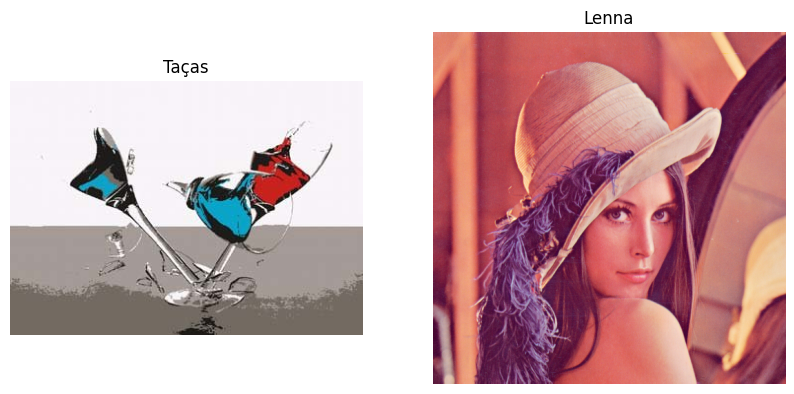

In [ ]:
url = "https://raw.githubusercontent.com/R1chardJr/Color_Reduction_GNG/main/tacas.jpg"
resp = urllib.request.urlopen(url)
image_array = np.asarray(bytearray(resp.read()), dtype=np.uint8)
image = cv2.imdecode(image_array, cv2.IMREAD_COLOR)
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

url2 = 'https://raw.githubusercontent.com/R1chardJr/Color_Reduction_GNG/main/Lenna.png'
resp2 = urllib.request.urlopen(url2)
image_array2 = np.asarray(bytearray(resp2.read()), dtype=np.uint8)
image2 = cv2.imdecode(image_array2, cv2.IMREAD_COLOR)
image_rgb2 = cv2.cvtColor(image2, cv2.COLOR_BGR2RGB)

plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.title("Taças")
plt.imshow(image_rgb)
plt.axis("off")

plt.subplot(1, 2, 2)
plt.title("Lenna")
plt.imshow(image_rgb2)
plt.axis("off")


# Definindo a rede GNG

In [ ]:
class GNGNode:
    def __init__(self, pos):
        self.pos = pos
        self.error = 0
        self.utility = 0
        self.connections = set()

class GNG:
    def __init__(self, max_nodes=100, max_iter=3000, eps_b=0.01, eps_n=0.0001,
                 alpha=0.5, lambda_insert=50, amax=90, beta=0.005):
        self.max_nodes = max_nodes
        self.max_iter = max_iter
        self.eps_b = eps_b
        self.eps_n = eps_n
        self.alpha = alpha
        self.lambda_insert = lambda_insert
        self.amax = amax
        self.beta = beta
        self.nodes = []
        self.edges_age = {}

    def _distance(self, a, b):
        return np.linalg.norm(a - b)

    def fit(self, data):
        data = np.array(data)
        self.nodes = [GNGNode(data[np.random.randint(len(data))]) for _ in range(2)]

        for step in range(1, self.max_iter + 1):
            x = data[np.random.randint(len(data))]

            #Encontrar os dois neurônios mais próximos
            dists = [self._distance(n.pos, x) for n in self.nodes]
            s1_idx, s2_idx = np.argsort(dists)[:2]
            s1, s2 = self.nodes[s1_idx], self.nodes[s2_idx]

            #Criar/conectar s1 <-> s2, idade 0
            s1.connections.add(s2_idx)
            s2.connections.add(s1_idx)
            self.edges_age[(s1_idx, s2_idx)] = 0
            self.edges_age[(s2_idx, s1_idx)] = 0

            #Atualizar erro do vencedor s1
            dist_sq = self._distance(s1.pos, x) ** 2
            s1.error += dist_sq

            #Atualizar pesos de s1 e vizinhos
            s1.pos += self.eps_b * (x - s1.pos)
            for idx in s1.connections:
                self.nodes[idx].pos += self.eps_n * (x - self.nodes[idx].pos)

            #Incrementar idade das conexões e remover velhas
            for idx in list(s1.connections):
                key = (s1_idx, idx)
                rev_key = (idx, s1_idx)

                if key in self.edges_age:
                    self.edges_age[key] += 1
                    age = self.edges_age[key]
                elif rev_key in self.edges_age:
                    self.edges_age[rev_key] += 1
                    age = self.edges_age[rev_key]
                else:
                    self.edges_age[key] = 1
                    age = 1

                if age > self.amax:
                    s1.connections.discard(idx)
                    self.nodes[idx].connections.discard(s1_idx)
                    self.edges_age.pop(key, None)
                    self.edges_age.pop(rev_key, None)

            #Remover neurônios desconectados
            self.nodes = [n for n in self.nodes if n.connections]

            #Inserção de novo neurônio
            if step % self.lambda_insert == 0 and len(self.nodes) < self.max_nodes:
                q_idx = np.argmax([n.error for n in self.nodes])
                q = self.nodes[q_idx]
                if not q.connections:
                    continue
                f_idx = max(q.connections, key=lambda idx: self.nodes[idx].error)
                f = self.nodes[f_idx]

                r_pos = (q.pos + f.pos) / 2
                r = GNGNode(r_pos)
                self.nodes.append(r)
                r_idx = len(self.nodes) - 1

                r.connections.update([q_idx, f_idx])
                q.connections.discard(f_idx)
                f.connections.discard(q_idx)
                q.connections.add(r_idx)
                f.connections.add(r_idx)

                q.error *= self.alpha
                f.error *= self.alpha
                r.error = q.error

            #Redução do erro
            for n in self.nodes:
                n.error *= (1 - self.beta)

    def get_centers(self):
        return np.array([n.pos for n in self.nodes])


# Teste inicial
Para começar foi utilizado os parâmetros default como ponto de partida para iniciar o projeto e a imagem tradiconal das taças que é muito utilizada em projetos de redução de cor.


🧠 Treinando GNG com max_nodes = 8...
📏 Inércia média: 9.72
🎯 Cores únicas após GNG: 8 (limite = 8)


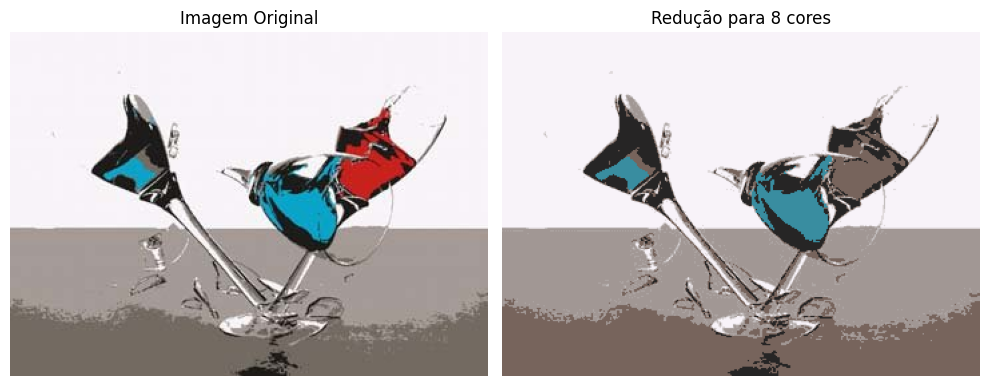

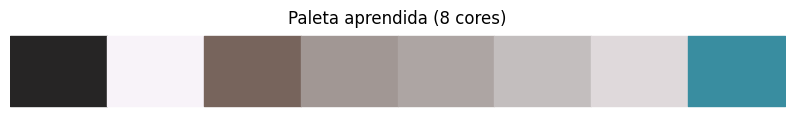


🧠 Treinando GNG com max_nodes = 16...
📏 Inércia média: 6.10
🎯 Cores únicas após GNG: 16 (limite = 16)


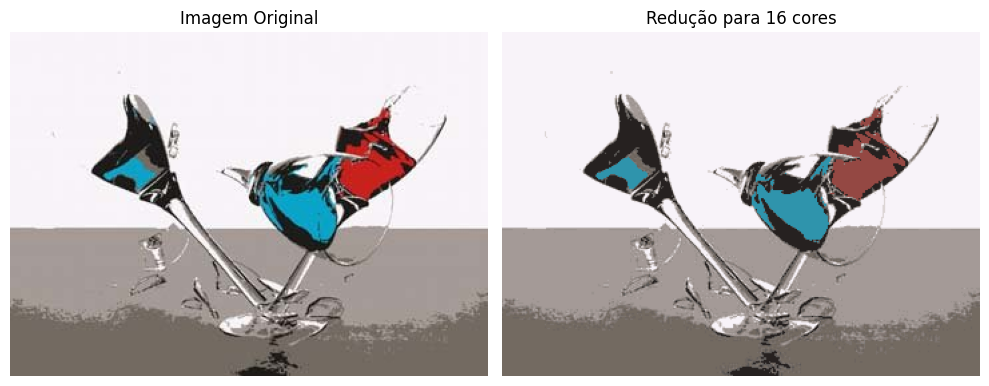

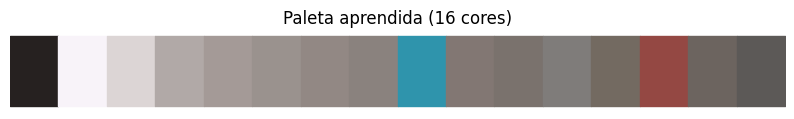


🧠 Treinando GNG com max_nodes = 32...
📏 Inércia média: 5.65
🎯 Cores únicas após GNG: 32 (limite = 32)


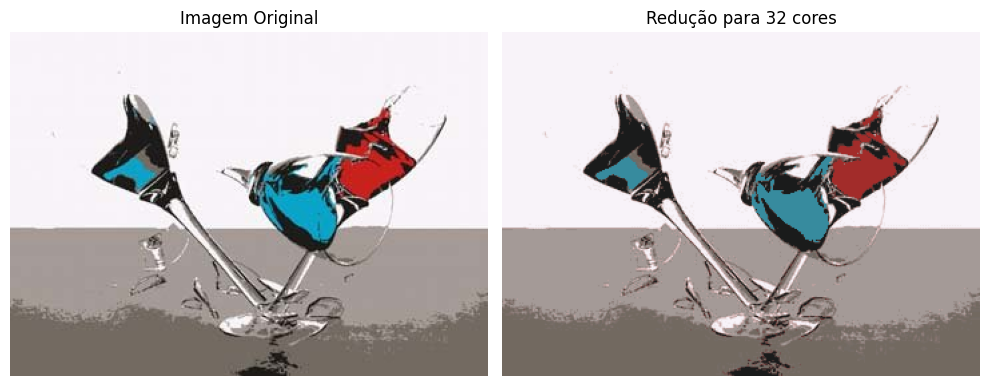

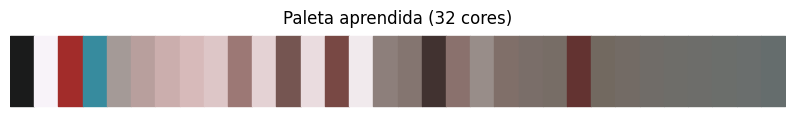


🧠 Treinando GNG com max_nodes = 64...
📏 Inércia média: 5.72
🎯 Cores únicas após GNG: 60 (limite = 64)


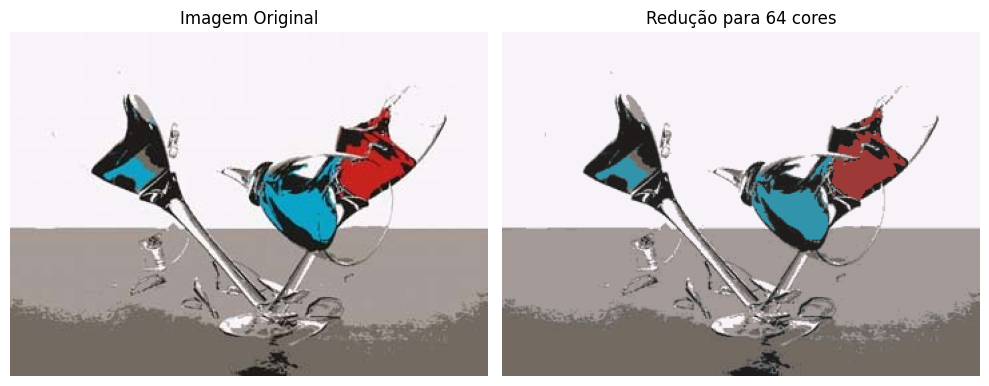

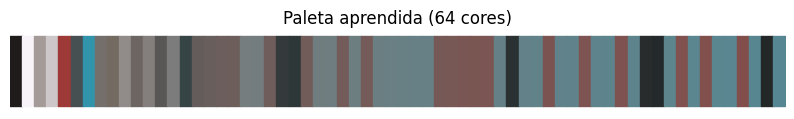


🧠 Treinando GNG com max_nodes = 128...
📏 Inércia média: 5.07
🎯 Cores únicas após GNG: 120 (limite = 128)


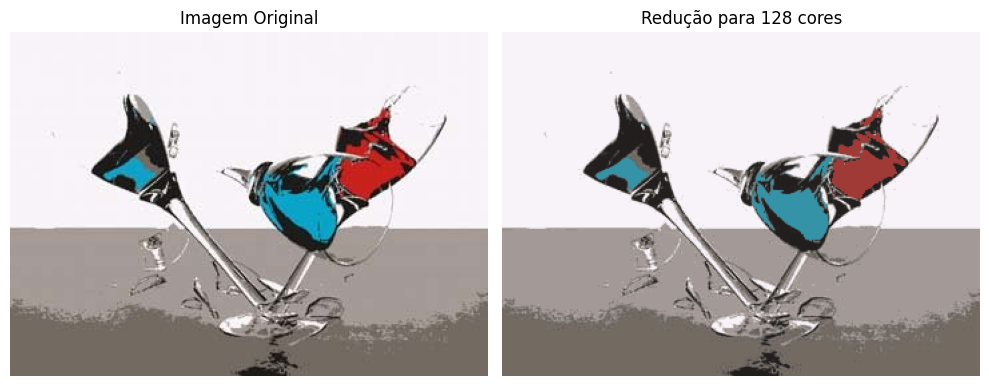

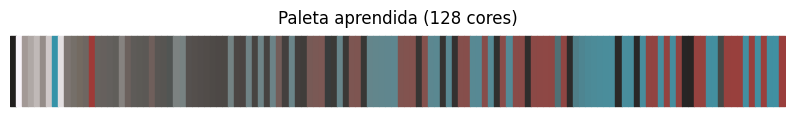

In [ ]:
url = "https://raw.githubusercontent.com/R1chardJr/Color_Reduction_GNG/main/tacas.jpg"
resp = urllib.request.urlopen(url)
image_array = np.asarray(bytearray(resp.read()), dtype=np.uint8)
image = cv2.imdecode(image_array, cv2.IMREAD_COLOR)
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
pixels = image_rgb.reshape(-1, 3).astype(np.float32)

def closest_color(pixel, centers):
    distances = np.linalg.norm(centers - pixel, axis=1)
    return centers[np.argmin(distances)]

def count_unique_colors(image_array):
    flat = image_array.reshape(-1, 3)
    unique_colors = np.unique(flat, axis=0)
    return len(unique_colors), flat.shape[0]

for max_nodes in [8, 16, 32, 64,128]:
    print(f"\n🧠 Treinando GNG com max_nodes = {max_nodes}...")

    gng = GNG(max_nodes=max_nodes, max_iter=7500, eps_b=0.01, eps_n=0.0001,
              alpha=0.5, lambda_insert=50, amax=90, beta=0.005)
    gng.fit(pixels)
    centers = gng.get_centers()

    reduced_pixels = np.array([closest_color(p, centers) for p in pixels])
    reduced_image = reduced_pixels.reshape(image_rgb.shape).astype(np.uint8)

    _, dists = pairwise_distances_argmin_min(pixels, centers)
    inertia = np.mean(dists)

    original_colors, original_pixels = count_unique_colors(image_rgb)
    reduced_colors, reduced_pixels = count_unique_colors(reduced_image)

    print(f"📏 Inércia média: {inertia:.2f}")
    print(f"🎯 Cores únicas após GNG: {reduced_colors} (limite = {max_nodes})")

    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.title("Imagem Original")
    plt.imshow(image_rgb)
    plt.axis("off")

    plt.subplot(1, 2, 2)
    plt.title(f"Redução para {max_nodes} cores")
    plt.imshow(reduced_image)
    plt.axis("off")
    plt.tight_layout()
    plt.show()

    plt.figure(figsize=(10, 1))
    for i, color in enumerate(centers.astype(np.uint8)):
        plt.fill_between([i, i + 1], 0, 1, color=color / 255.0)
    plt.xlim(0, len(centers))
    plt.axis('off')
    plt.title(f'Paleta aprendida ({len(centers)} cores)')
    plt.show()


O número máximo de interações foi fixado em 7500 que seria a média entre Redução razoável (max_iter=3000) e alta qualidade(10000). Tambem visando menor custo computacional, já que o objetivo geral é esse.

# Variando as taxas de aprendizado
Agora é iniciado a parte de testes para descobrir os melhores parametros para a rede GNG.<p>
Os primeiros parâmetros a serem testados é a taxa de aprendizado ( tanto dos vizinhos como do vencedor)


🔧 Treinando GNG com eps_b = 0.05, eps_n = 0.005...
📏 Inércia média: 3.44
🎯 Cores únicas após GNG: 64 (máx permitido: 64)


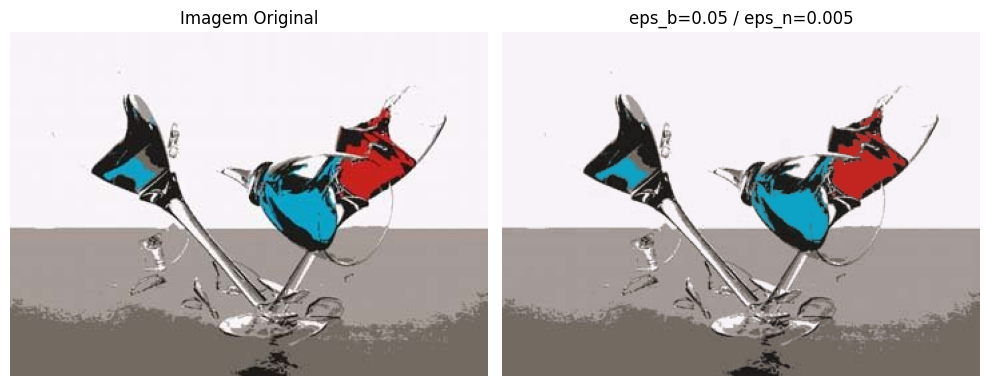

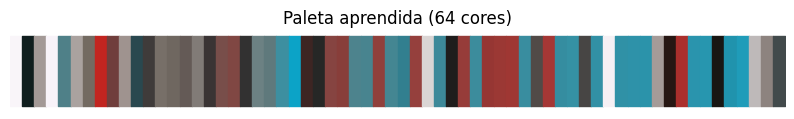


🔧 Treinando GNG com eps_b = 0.01, eps_n = 0.001...
📏 Inércia média: 5.08
🎯 Cores únicas após GNG: 62 (máx permitido: 64)


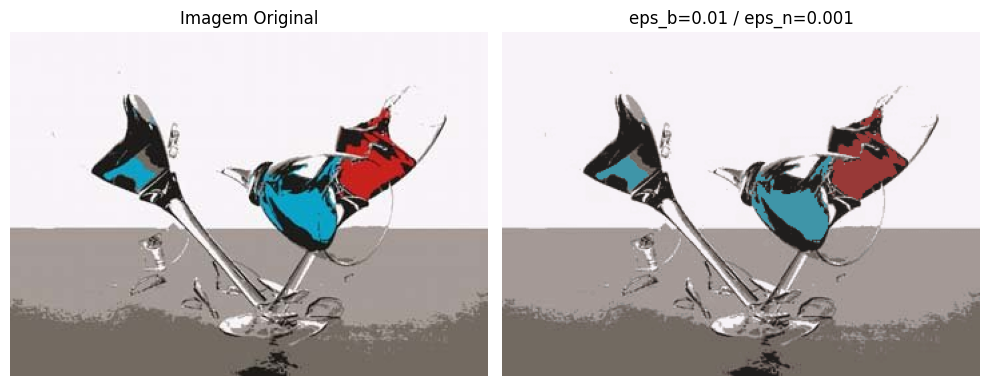

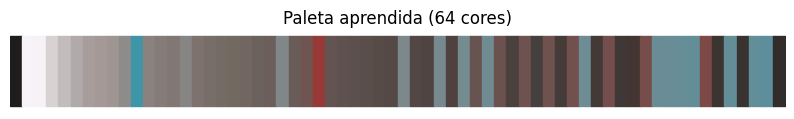


🔧 Treinando GNG com eps_b = 0.005, eps_n = 0.0005...
📏 Inércia média: 6.60
🎯 Cores únicas após GNG: 63 (máx permitido: 64)


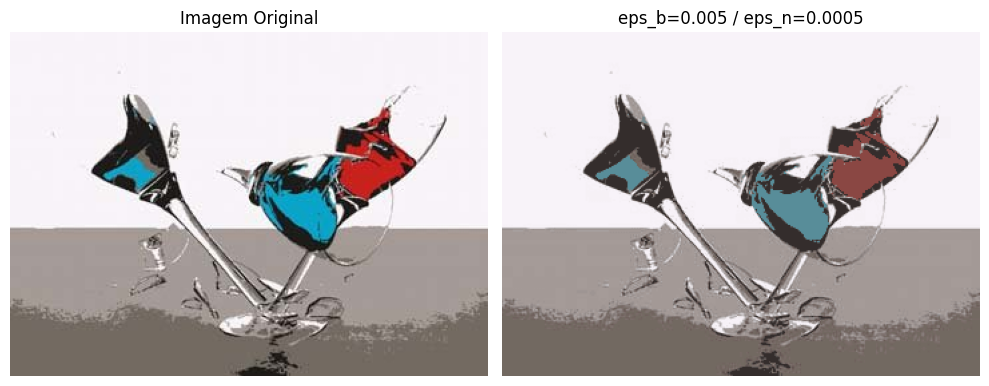

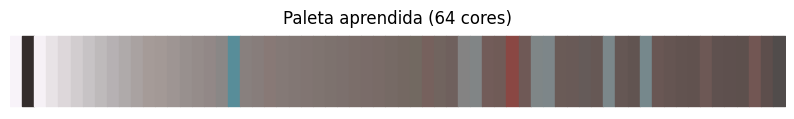


🔧 Treinando GNG com eps_b = 0.001, eps_n = 0.0001...
📏 Inércia média: 9.10
🎯 Cores únicas após GNG: 47 (máx permitido: 64)


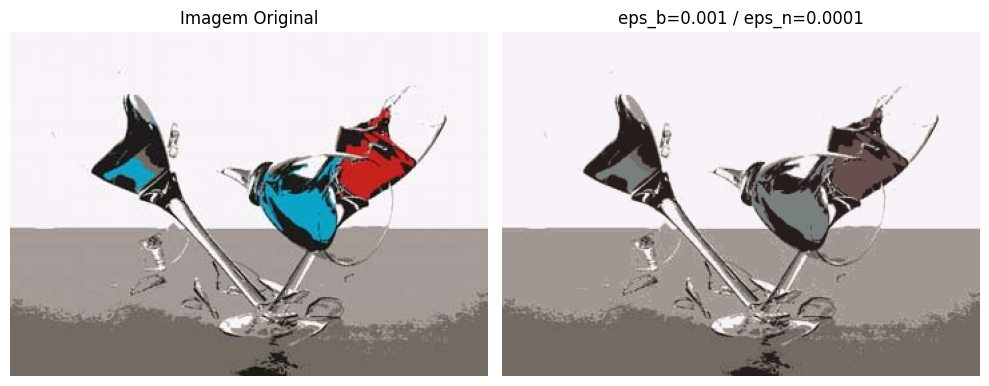

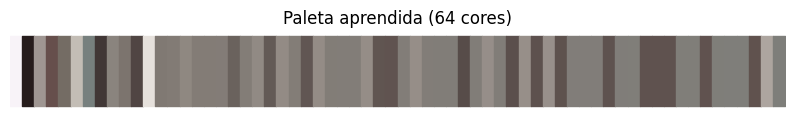


🔧 Treinando GNG com eps_b = 0.0005, eps_n = 5e-05...
📏 Inércia média: 18.81
🎯 Cores únicas após GNG: 50 (máx permitido: 64)


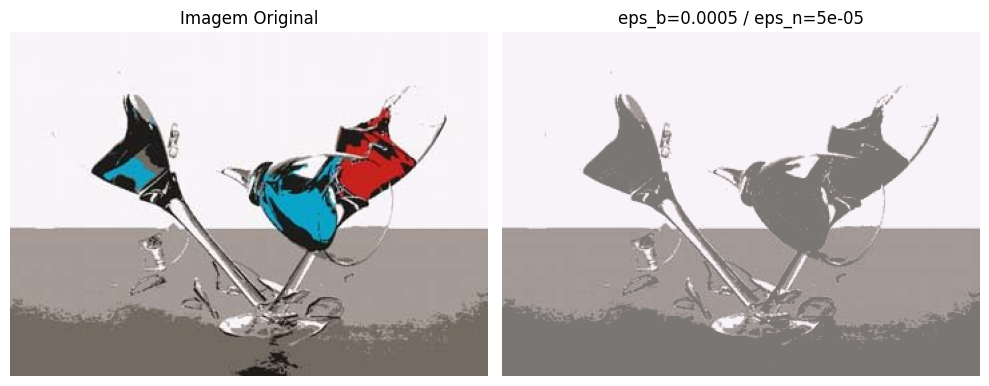

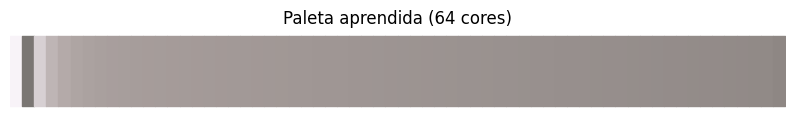

In [ ]:
url = "https://raw.githubusercontent.com/R1chardJr/Color_Reduction_GNG/main/tacas.jpg"
resp = urllib.request.urlopen(url)
image_array = np.asarray(bytearray(resp.read()), dtype=np.uint8)
image = cv2.imdecode(image_array, cv2.IMREAD_COLOR)
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
pixels = image_rgb.reshape(-1, 3).astype(np.float32)

def closest_color(pixel, centers):
    distances = np.linalg.norm(centers - pixel, axis=1)
    return centers[np.argmin(distances)]

def count_unique_colors(image_array):
    flat = image_array.reshape(-1, 3)
    unique_colors = np.unique(flat, axis=0)
    return len(unique_colors), flat.shape[0]

taxas = [
    (0.05, 0.005),
    (0.01, 0.001),
    (0.005, 0.0005),
    (0.001, 0.0001),
    (0.0005, 0.00005),
]
max_nodes = 64

for eps_b, eps_n in taxas:
    print(f"\n🔧 Treinando GNG com eps_b = {eps_b}, eps_n = {eps_n}...")

    gng = GNG(max_nodes=max_nodes, max_iter=7500, eps_b=eps_b, eps_n=eps_n,
              alpha=0.5, lambda_insert=50, amax=90, beta=0.005)
    gng.fit(pixels)
    centers = gng.get_centers()

    reduced_pixels = np.array([closest_color(p, centers) for p in pixels])
    reduced_image = reduced_pixels.reshape(image_rgb.shape).astype(np.uint8)

    _, dists = pairwise_distances_argmin_min(pixels, centers)
    inertia = np.mean(dists)

    original_colors, original_pixels = count_unique_colors(image_rgb)
    reduced_colors, reduced_pixels = count_unique_colors(reduced_image)

    print(f"📏 Inércia média: {inertia:.2f}")
    print(f"🎯 Cores únicas após GNG: {reduced_colors} (máx permitido: {max_nodes})")

    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.title("Imagem Original")
    plt.imshow(image_rgb)
    plt.axis("off")

    plt.subplot(1, 2, 2)
    plt.title(f"eps_b={eps_b} / eps_n={eps_n}")
    plt.imshow(reduced_image)
    plt.axis("off")
    plt.tight_layout()
    plt.show()

    plt.figure(figsize=(10, 1))
    for i, color in enumerate(centers.astype(np.uint8)):
        plt.fill_between([i, i + 1], 0, 1, color=color / 255.0)
    plt.xlim(0, len(centers))
    plt.axis('off')
    plt.title(f'Paleta aprendida ({len(centers)} cores)')
    plt.show()


É perceptivel tanto numericamente(por meio da medida da inércia) como visivelmente(comparando a imagem antes e depois do uso da GNG) que com as taxas
eps_b = 0.05, eps_n = 0.005 temos os melhores resultados. Então a partir de agora será utilizado esses valores como parâmetros.

# Testando diferentes números máximos de neurônios com nova taxa de aprendizado


🧠 Treinando GNG com max_nodes = 8...
📏 Inércia média: 8.97
🎯 Cores únicas após GNG: 8 (limite = 8)


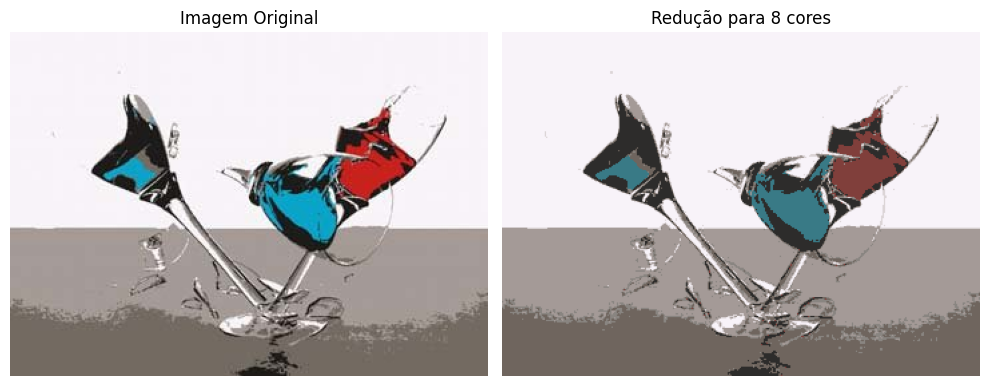

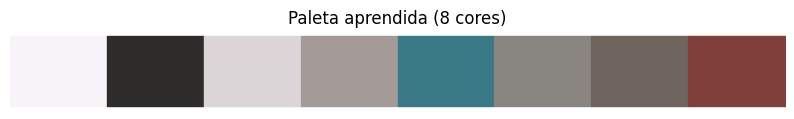


🧠 Treinando GNG com max_nodes = 16...
📏 Inércia média: 5.56
🎯 Cores únicas após GNG: 16 (limite = 16)


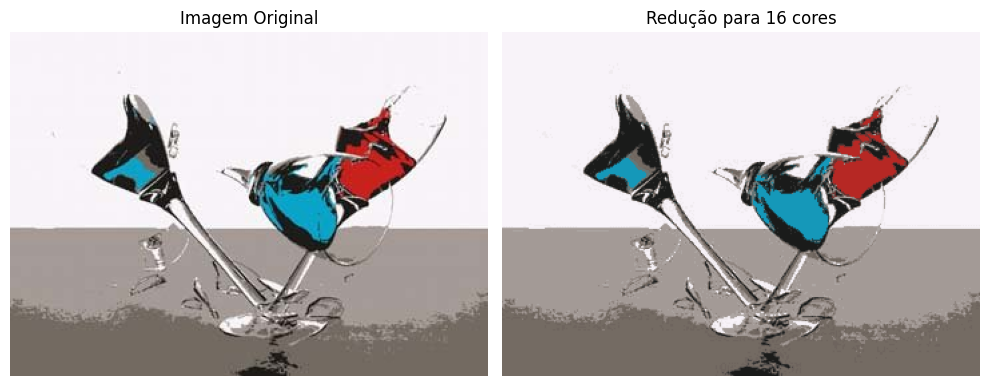

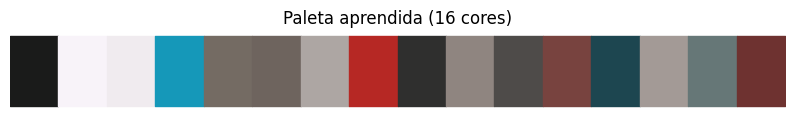


🧠 Treinando GNG com max_nodes = 32...
📏 Inércia média: 4.49
🎯 Cores únicas após GNG: 32 (limite = 32)


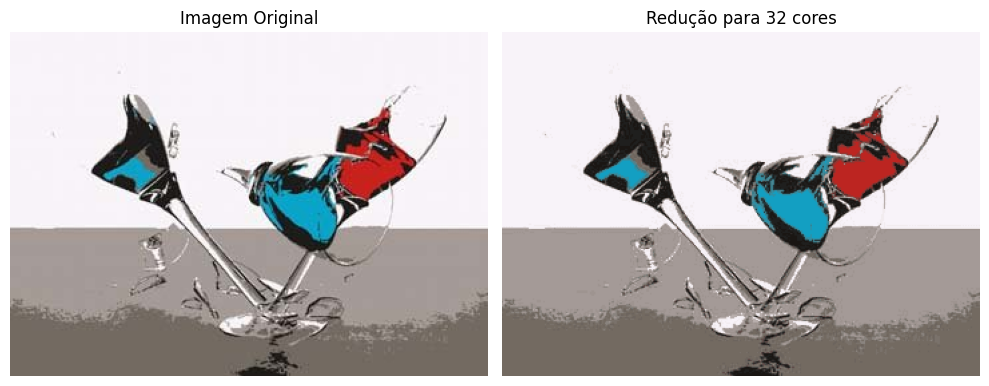

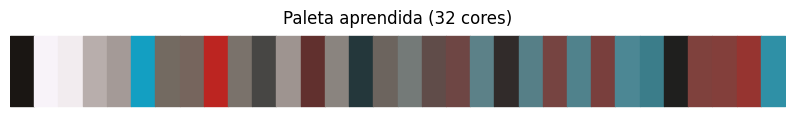


🧠 Treinando GNG com max_nodes = 64...
📏 Inércia média: 3.50
🎯 Cores únicas após GNG: 64 (limite = 64)


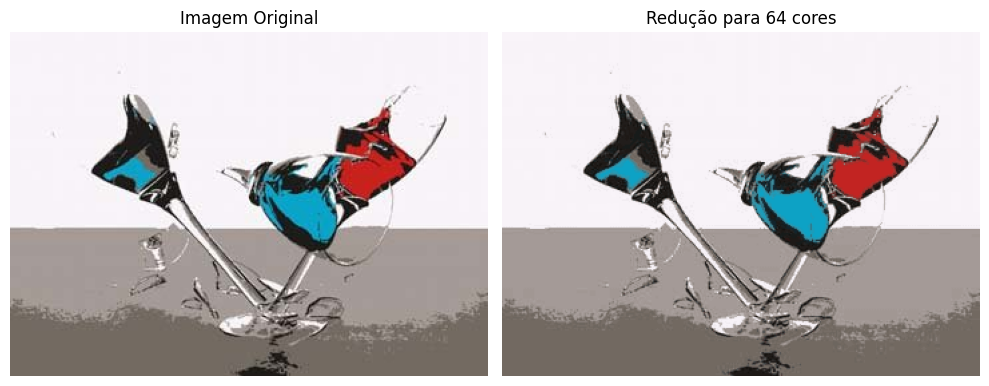

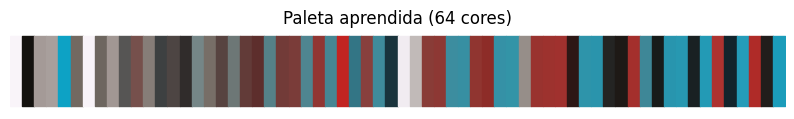


🧠 Treinando GNG com max_nodes = 128...
📏 Inércia média: 2.66
🎯 Cores únicas após GNG: 126 (limite = 128)


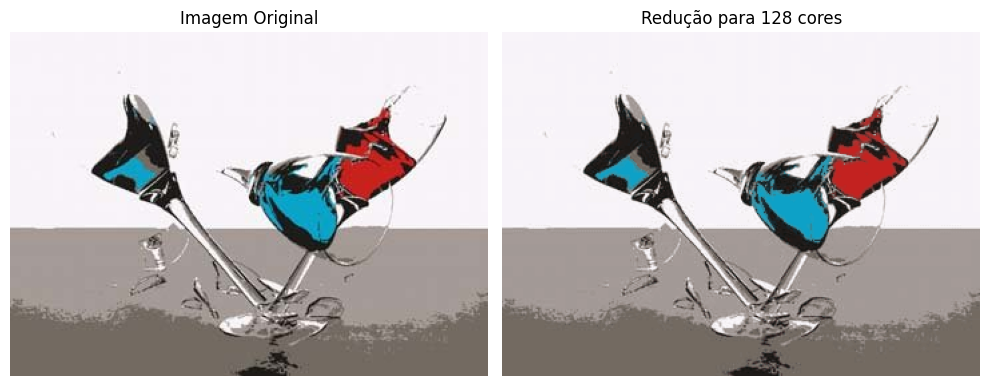

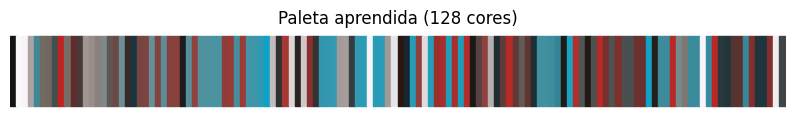

In [ ]:
url = "https://raw.githubusercontent.com/R1chardJr/Color_Reduction_GNG/main/tacas.jpg"
resp = urllib.request.urlopen(url)
image_array = np.asarray(bytearray(resp.read()), dtype=np.uint8)
image = cv2.imdecode(image_array, cv2.IMREAD_COLOR)
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
pixels = image_rgb.reshape(-1, 3).astype(np.float32)

def closest_color(pixel, centers):
    distances = np.linalg.norm(centers - pixel, axis=1)
    return centers[np.argmin(distances)]

def count_unique_colors(image_array):
    flat = image_array.reshape(-1, 3)
    unique_colors = np.unique(flat, axis=0)
    return len(unique_colors), flat.shape[0]

for max_nodes in [8, 16, 32, 64,128]:
    print(f"\n🧠 Treinando GNG com max_nodes = {max_nodes}...")

    gng = GNG(max_nodes=max_nodes, max_iter=7500, eps_b=0.05, eps_n=0.005,
              alpha=0.5, lambda_insert=50, amax=90, beta=0.005)
    gng.fit(pixels)
    centers = gng.get_centers()

    reduced_pixels = np.array([closest_color(p, centers) for p in pixels])
    reduced_image = reduced_pixels.reshape(image_rgb.shape).astype(np.uint8)

    _, dists = pairwise_distances_argmin_min(pixels, centers)
    inertia = np.mean(dists)

    original_colors, original_pixels = count_unique_colors(image_rgb)
    reduced_colors, reduced_pixels = count_unique_colors(reduced_image)

    print(f"📏 Inércia média: {inertia:.2f}")
    print(f"🎯 Cores únicas após GNG: {reduced_colors} (limite = {max_nodes})")

    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.title("Imagem Original")
    plt.imshow(image_rgb)
    plt.axis("off")

    plt.subplot(1, 2, 2)
    plt.title(f"Redução para {max_nodes} cores")
    plt.imshow(reduced_image)
    plt.axis("off")
    plt.tight_layout()
    plt.show()

    plt.figure(figsize=(10, 1))
    for i, color in enumerate(centers.astype(np.uint8)):
        plt.fill_between([i, i + 1], 0, 1, color=color / 255.0)
    plt.xlim(0, len(centers))
    plt.axis('off')
    plt.title(f'Paleta aprendida ({len(centers)} cores)')
    plt.show()


Como podemos ver, limitando o numero máximo de iteracões a 7500, com 128 neurônios como o número máximo de neurônios obtemos os melhores resultados. Então será usado esse padrão.

# Testando diferentes lambdas


🧠 Treinando GNG com λ = 20...
📏 Inércia média: 3.10
🎯 Cores únicas após GNG: 122 (limite = 128)


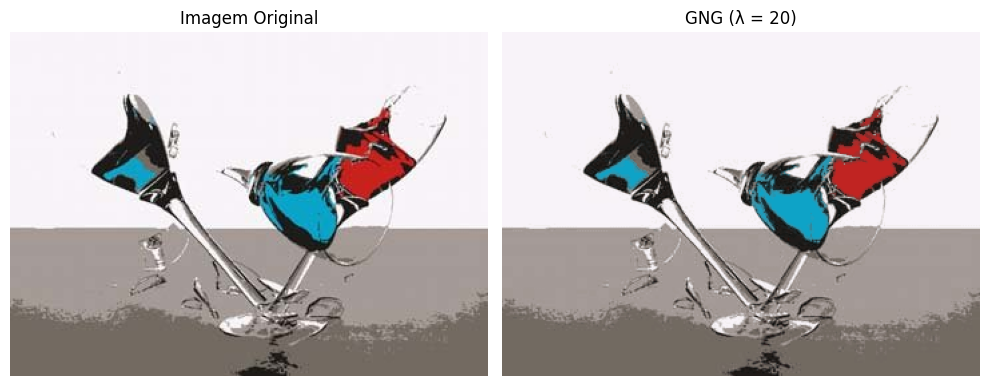

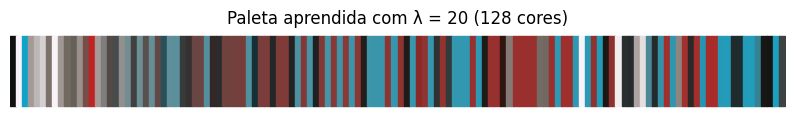


🧠 Treinando GNG com λ = 35...
📏 Inércia média: 2.61
🎯 Cores únicas após GNG: 127 (limite = 128)


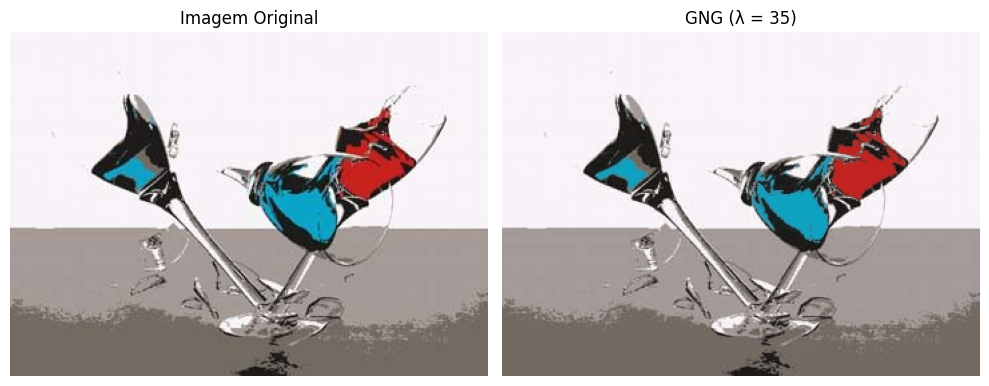

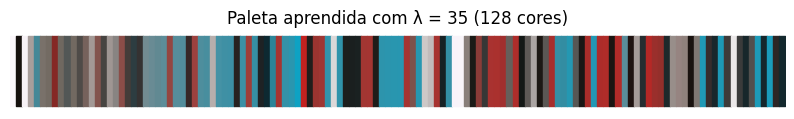


🧠 Treinando GNG com λ = 50...
📏 Inércia média: 2.80
🎯 Cores únicas após GNG: 128 (limite = 128)


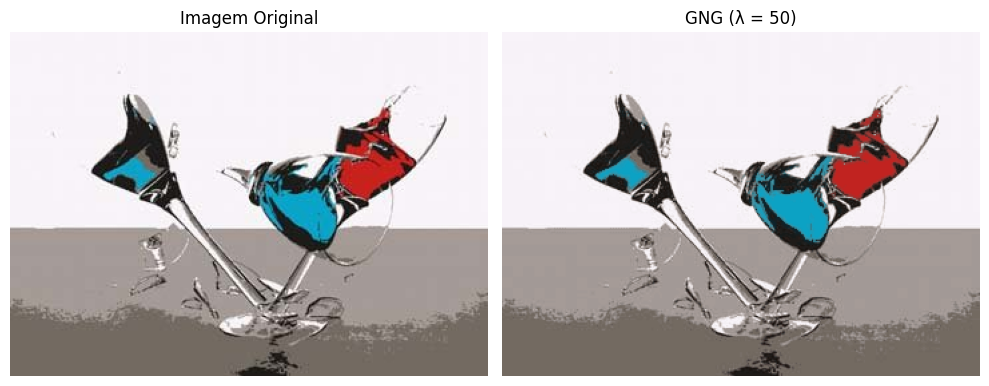

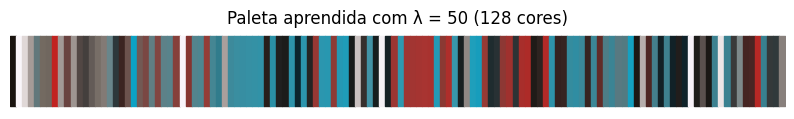


🧠 Treinando GNG com λ = 70...
📏 Inércia média: 2.69
🎯 Cores únicas após GNG: 109 (limite = 128)


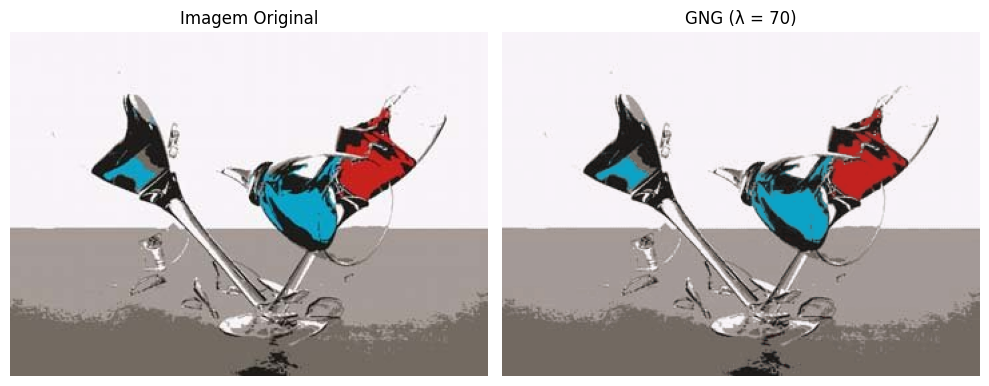

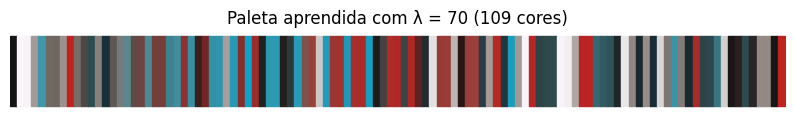


🧠 Treinando GNG com λ = 100...
📏 Inércia média: 3.19
🎯 Cores únicas após GNG: 77 (limite = 128)


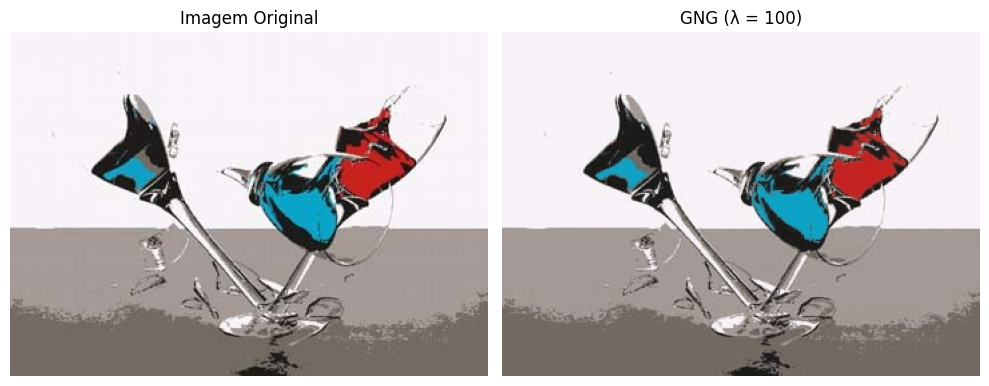

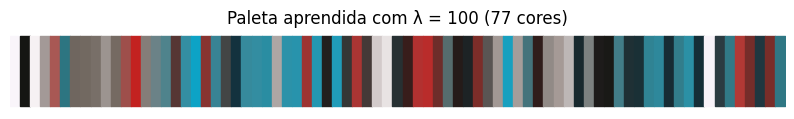

In [ ]:
url = "https://raw.githubusercontent.com/R1chardJr/Color_Reduction_GNG/main/tacas.jpg"
resp = urllib.request.urlopen(url)
image_array = np.asarray(bytearray(resp.read()), dtype=np.uint8)
image = cv2.imdecode(image_array, cv2.IMREAD_COLOR)
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
pixels = image_rgb.reshape(-1, 3).astype(np.float32)

def closest_color(pixel, centers):
    distances = np.linalg.norm(centers - pixel, axis=1)
    return centers[np.argmin(distances)]

def count_unique_colors(image_array):
    flat = image_array.reshape(-1, 3)
    unique_colors = np.unique(flat, axis=0)
    return len(unique_colors), flat.shape[0]

lambda_values = [20, 35, 50, 70, 100]
max_nodes = 128
max_iter = 7500

for lambda_insert in lambda_values:
    print(f"\n🧠 Treinando GNG com λ = {lambda_insert}...")

    gng = GNG(max_nodes=max_nodes, max_iter=max_iter,
              eps_b=0.05, eps_n=0.005,
              alpha=0.5, lambda_insert=lambda_insert,
              amax=90, beta=0.005)

    gng.fit(pixels)
    centers = gng.get_centers()

    reduced_pixels = np.array([closest_color(p, centers) for p in pixels])
    reduced_image = reduced_pixels.reshape(image_rgb.shape).astype(np.uint8)

    _, dists = pairwise_distances_argmin_min(pixels, centers)
    inertia = np.mean(dists)

    original_colors, original_pixels = count_unique_colors(image_rgb)
    reduced_colors, reduced_pixels = count_unique_colors(reduced_image)

    print(f"📏 Inércia média: {inertia:.2f}")
    print(f"🎯 Cores únicas após GNG: {reduced_colors} (limite = {max_nodes})")

    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.title("Imagem Original")
    plt.imshow(image_rgb)
    plt.axis("off")

    plt.subplot(1, 2, 2)
    plt.title(f"GNG (λ = {lambda_insert})")
    plt.imshow(reduced_image)
    plt.axis("off")

    plt.tight_layout()
    plt.show()

    plt.figure(figsize=(10, 1))
    for i, color in enumerate(centers.astype(np.uint8)):
        plt.fill_between([i, i + 1], 0, 1, color=color / 255.0)
    plt.xlim(0, len(centers))
    plt.axis('off')
    plt.title(f'Paleta aprendida com λ = {lambda_insert} ({len(centers)} cores)')
    plt.show()


No caso da alteração do λ,é possível observar que a alteração desse parâmetro não tem tanto efeito no resultado final, apenas mudaças de refinamento.Então será mantido λ igual a 50,já que faz parte dos parâmetros default.

# Avaliando os resultados

Primeiro, o modelo é treinado com os parâmetros que se saíram melhor nos testes anteriores e a partir disso será feito algumas avaliações considerando esse resultado, dentre eles o PCA e o Silhouette score (para avaliar a homogeneidade). Fora a inércia que já esta sendo avaliada constantemente tambem.

🖼️ Imagem original: 10552 cores únicas em 92364 pixels
🎯 Imagem reduzida: 128 cores únicas em 92364 pixels
📏 Inércia média: 2.54
🎯 Cores únicas após GNG: 128 (limite = 128)


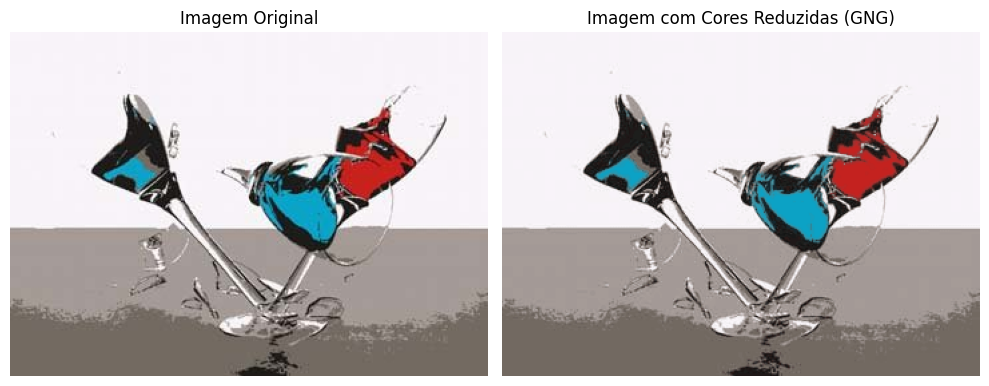

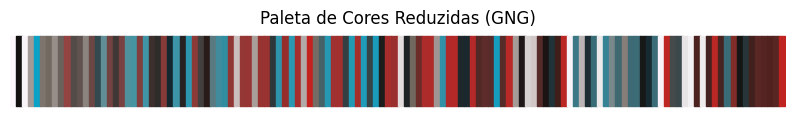

In [ ]:
url = "https://raw.githubusercontent.com/R1chardJr/Color_Reduction_GNG/main/tacas.jpg"
resp = urllib.request.urlopen(url)
image_array = np.asarray(bytearray(resp.read()), dtype=np.uint8)
image = cv2.imdecode(image_array, cv2.IMREAD_COLOR)
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
pixels = image_rgb.reshape(-1, 3).astype(np.float32)

gng = GNG(max_nodes=128, max_iter=7500, eps_b=0.05, eps_n=0.005, alpha=0.5, lambda_insert=50, amax=90, beta=0.005)
gng.fit(pixels)
centers = gng.get_centers()

def closest_color(pixel):
    distances = np.linalg.norm(centers - pixel, axis=1)
    return centers[np.argmin(distances)]

reduced_pixels = np.array([closest_color(p) for p in pixels])
reduced_image = reduced_pixels.reshape(image_rgb.shape).astype(np.uint8)

def count_unique_colors(image_array):
    flat = image_array.reshape(-1, 3)
    unique_colors = np.unique(flat, axis=0)
    return len(unique_colors), flat.shape[0]

original_colors, original_pixels = count_unique_colors(image_rgb)
reduced_colors, reduced_pixels = count_unique_colors(reduced_image)

print(f"🖼️ Imagem original: {original_colors} cores únicas em {original_pixels} pixels")
print(f"🎯 Imagem reduzida: {reduced_colors} cores únicas em {reduced_pixels} pixels")

_, dists = pairwise_distances_argmin_min(pixels, centers)
inertia = np.mean(dists)

original_colors, original_pixels = count_unique_colors(image_rgb)
reduced_colors, reduced_pixels = count_unique_colors(reduced_image)

print(f"📏 Inércia média: {inertia:.2f}")
print(f"🎯 Cores únicas após GNG: {reduced_colors} (limite = {max_nodes})")

plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.title("Imagem Original")
plt.imshow(image_rgb)
plt.axis("off")

plt.subplot(1, 2, 2)
plt.title("Imagem com Cores Reduzidas (GNG)")
plt.imshow(reduced_image)
plt.axis("off")

plt.tight_layout()
plt.show()

plt.figure(figsize=(10, 1))
for i, color in enumerate(centers.astype(np.uint8)):
    plt.fill_between([i, i + 1], 0, 1, color=color / 255.0)
plt.xlim(0, len(centers))
plt.axis('off')
plt.title('Paleta de Cores Reduzidas (GNG)')
plt.show()

De começo já podemos ver uma inércia baixissima, mostrando que os neurônios estão bem próximos dos dados originais e estão representando fielmente os dados. Além disso, a imagem antes e depois a olho nu são a mesma, a diferença é quase inexistente mesmo após a redução de 10552 cores para 124, uma redução de aproximadamente 85 vezes no número de cores.

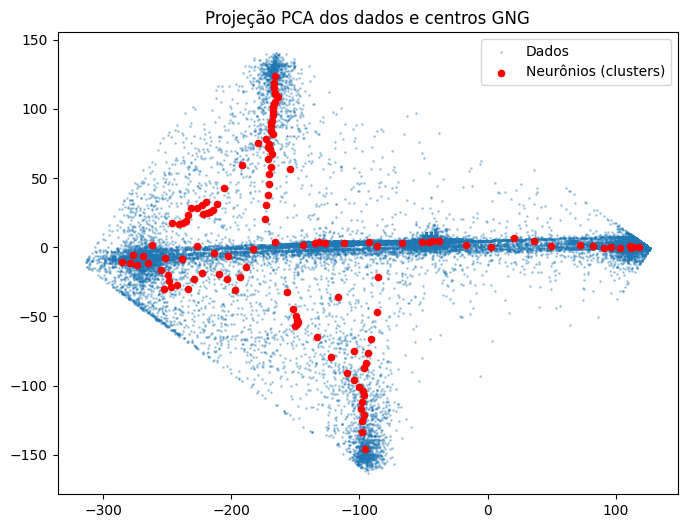

In [ ]:
pca = PCA(n_components=2)
data_2d = pca.fit_transform(pixels)
centers_2d = pca.transform(centers)

plt.figure(figsize=(8, 6))
plt.scatter(data_2d[:, 0], data_2d[:, 1], s=1, alpha=0.3, label='Dados')
plt.scatter(centers_2d[:, 0], centers_2d[:, 1], c='red', s=20, label='Neurônios (clusters)')
plt.title('Projeção PCA dos dados e centros GNG')
plt.legend()
plt.show()


Nessa projeção PCA temos a projeção da escala RGB. Os "dados"(pontos azuis) representam as cores originais da imagem, já os "neurônios"(pontos vermelhos representam as novas cores após a redução.<p>
Então, analisando o PCA é possível ver que temos as novas cores como boas representações das cores originais, sempre onde há uma concentração das cores originais, também há neurônios para representar essa região.


In [ ]:
# Atribuir rótulos de cluster para cada pixel (baseado no neurônio mais próximo)
labels = np.argmin(np.linalg.norm(pixels[:, None] - centers[None, :], axis=2), axis=1)

score = silhouette_score(pixels, labels)
print(f"🧪 Silhouette score (homogeneidade): {score:.3f}")


🧪 Silhouette score (homogeneidade): 0.641


Analisando a homogeneidade, temos um Silhouette score de 0.641, que é razoavelmente próximo de 1, mostrando que os clusters estão separados de forma boa, isso é dericado da imagem original tambem e as cores que ela tem que na maior parte são bem distintas.

#Fazendo os mesmos testes mas agora com uma imagem diferente
Agora com a imagem da Lenna, que é muito utilizada tambem em projetos de redução de cores, iremos efetuar o mesmo processo para validar o modelo.


🔧 Treinando GNG com eps_b = 0.05, eps_n = 0.005...
📏 Inércia média: 8.38
🎯 Cores únicas após GNG: 64 (máx permitido: 64)


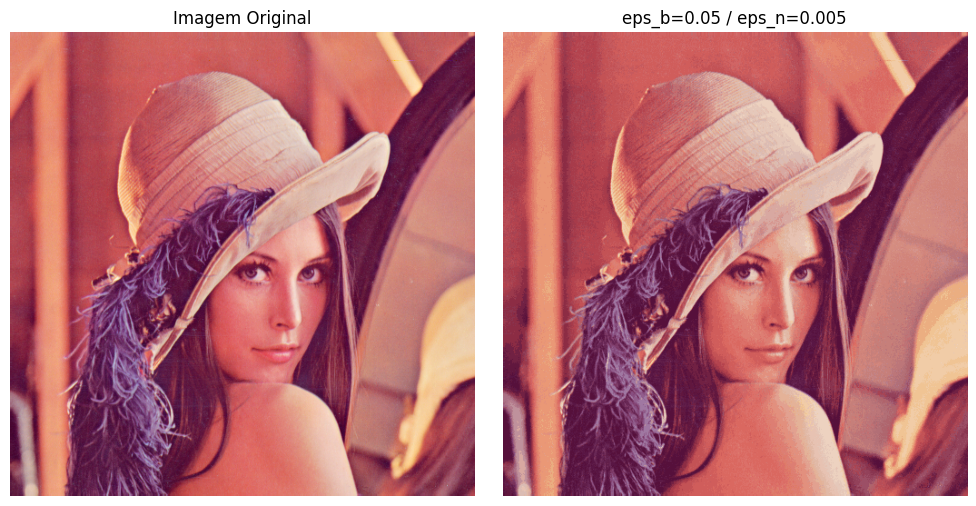

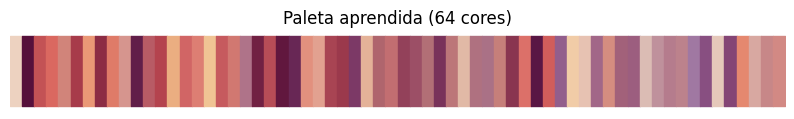


🔧 Treinando GNG com eps_b = 0.01, eps_n = 0.001...
📏 Inércia média: 10.09
🎯 Cores únicas após GNG: 64 (máx permitido: 64)


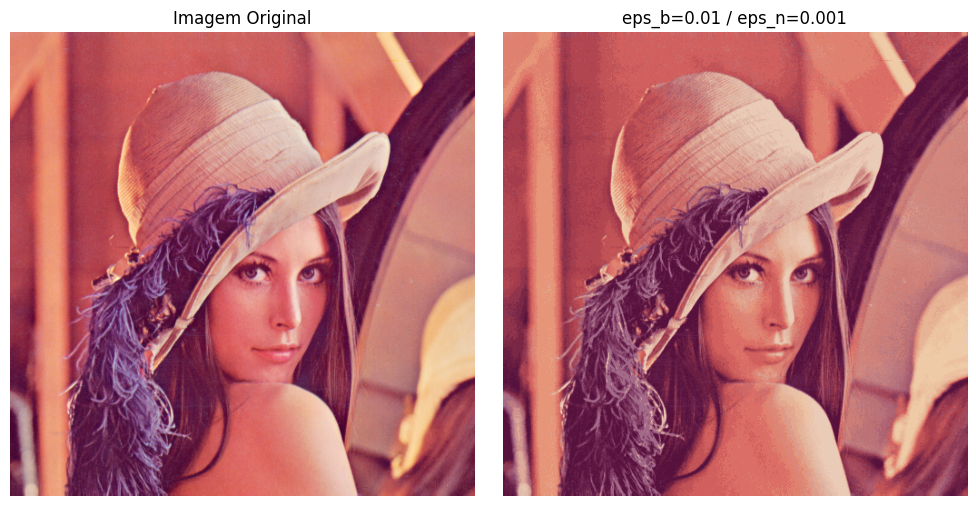

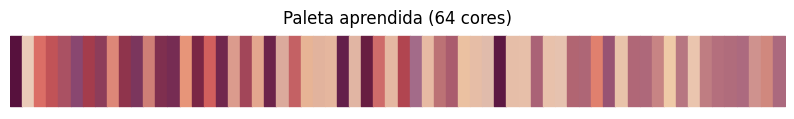


🔧 Treinando GNG com eps_b = 0.005, eps_n = 0.0005...
📏 Inércia média: 12.22
🎯 Cores únicas após GNG: 63 (máx permitido: 64)


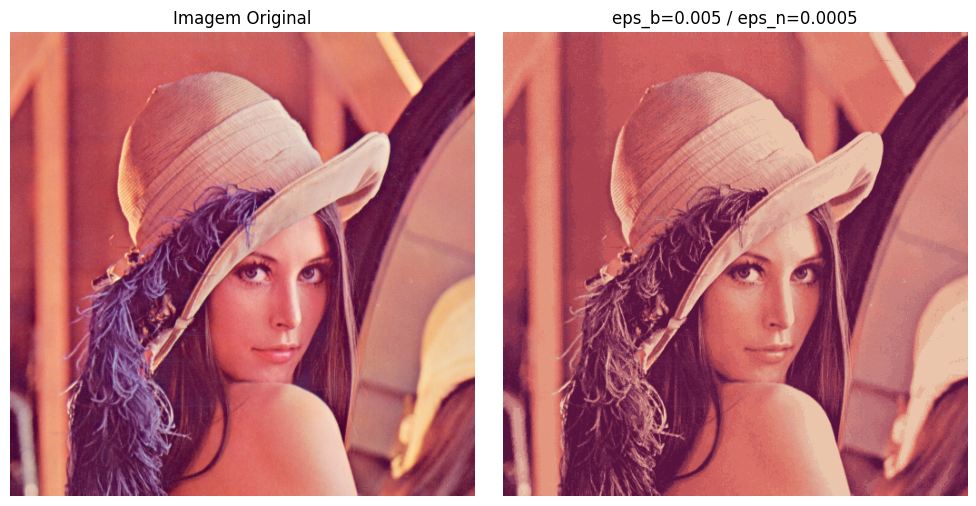

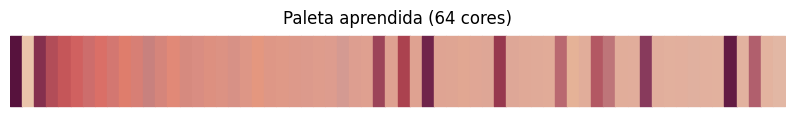


🔧 Treinando GNG com eps_b = 0.001, eps_n = 0.0001...
📏 Inércia média: 23.33
🎯 Cores únicas após GNG: 62 (máx permitido: 64)


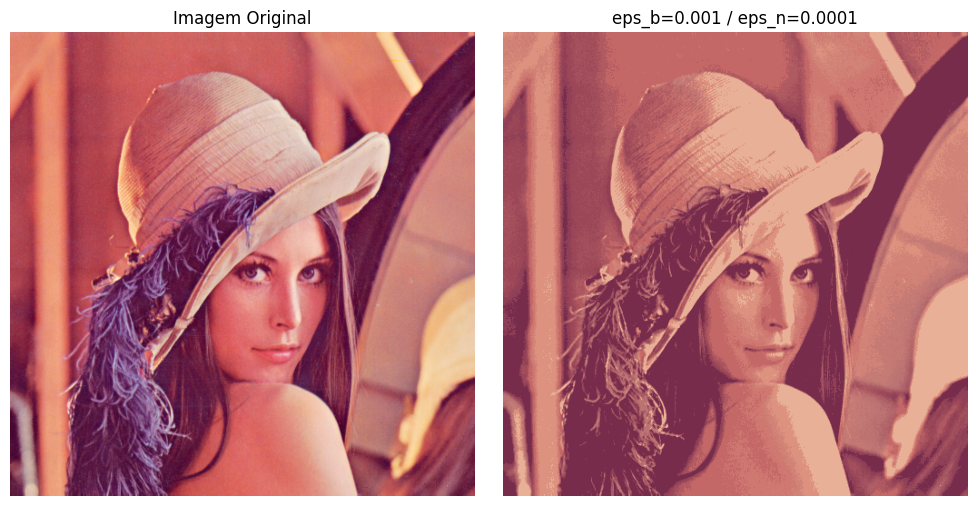

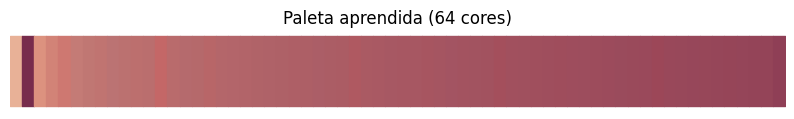


🔧 Treinando GNG com eps_b = 0.0005, eps_n = 5e-05...
📏 Inércia média: 24.72
🎯 Cores únicas após GNG: 38 (máx permitido: 64)


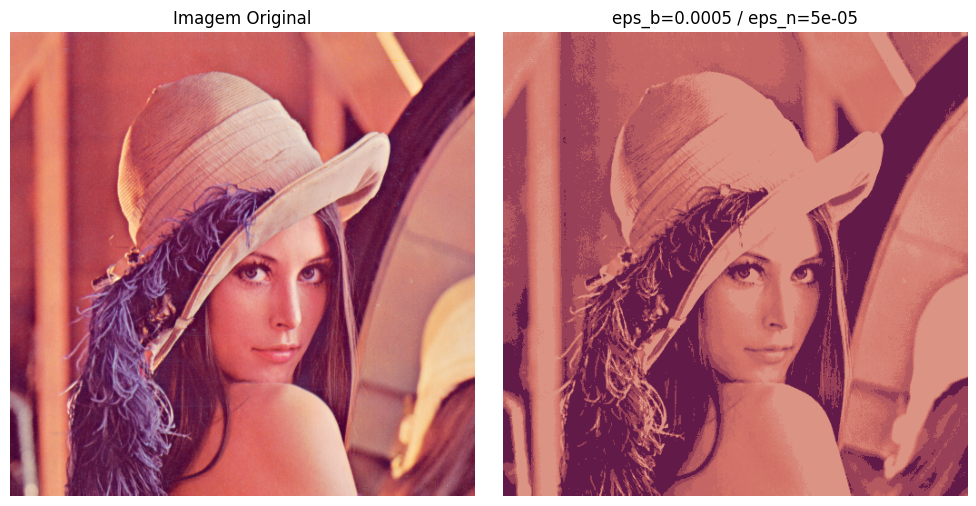

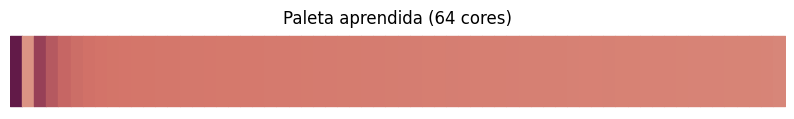

In [ ]:
url = 'https://raw.githubusercontent.com/R1chardJr/Color_Reduction_GNG/main/Lenna.png'
resp = urllib.request.urlopen(url)
image_array = np.asarray(bytearray(resp.read()), dtype=np.uint8)
image = cv2.imdecode(image_array, cv2.IMREAD_COLOR)
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
pixels = image_rgb.reshape(-1, 3).astype(np.float32)

def closest_color(pixel, centers):
    distances = np.linalg.norm(centers - pixel, axis=1)
    return centers[np.argmin(distances)]

def count_unique_colors(image_array):
    flat = image_array.reshape(-1, 3)
    unique_colors = np.unique(flat, axis=0)
    return len(unique_colors), flat.shape[0]

taxas = [
    (0.05, 0.005),
    (0.01, 0.001),
    (0.005, 0.0005),
    (0.001, 0.0001),
    (0.0005, 0.00005),
]
max_nodes = 64

for eps_b, eps_n in taxas:
    print(f"\n🔧 Treinando GNG com eps_b = {eps_b}, eps_n = {eps_n}...")

    gng = GNG(max_nodes=max_nodes, max_iter=7500, eps_b=eps_b, eps_n=eps_n,
              alpha=0.5, lambda_insert=50, amax=90, beta=0.005)
    gng.fit(pixels)
    centers = gng.get_centers()

    reduced_pixels = np.array([closest_color(p, centers) for p in pixels])
    reduced_image = reduced_pixels.reshape(image_rgb.shape).astype(np.uint8)

    _, dists = pairwise_distances_argmin_min(pixels, centers)
    inertia = np.mean(dists)

    original_colors, original_pixels = count_unique_colors(image_rgb)
    reduced_colors, reduced_pixels = count_unique_colors(reduced_image)

    print(f"📏 Inércia média: {inertia:.2f}")
    print(f"🎯 Cores únicas após GNG: {reduced_colors} (máx permitido: {max_nodes})")

    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.title("Imagem Original")
    plt.imshow(image_rgb)
    plt.axis("off")

    plt.subplot(1, 2, 2)
    plt.title(f"eps_b={eps_b} / eps_n={eps_n}")
    plt.imshow(reduced_image)
    plt.axis("off")
    plt.tight_layout()
    plt.show()

    plt.figure(figsize=(10, 1))
    for i, color in enumerate(centers.astype(np.uint8)):
        plt.fill_between([i, i + 1], 0, 1, color=color / 255.0)
    plt.xlim(0, len(centers))
    plt.axis('off')
    plt.title(f'Paleta aprendida ({len(centers)} cores)')
    plt.show()



🧠 Treinando GNG com max_nodes = 8...
📏 Inércia média: 18.53
🎯 Cores únicas após GNG: 8 (limite = 8)


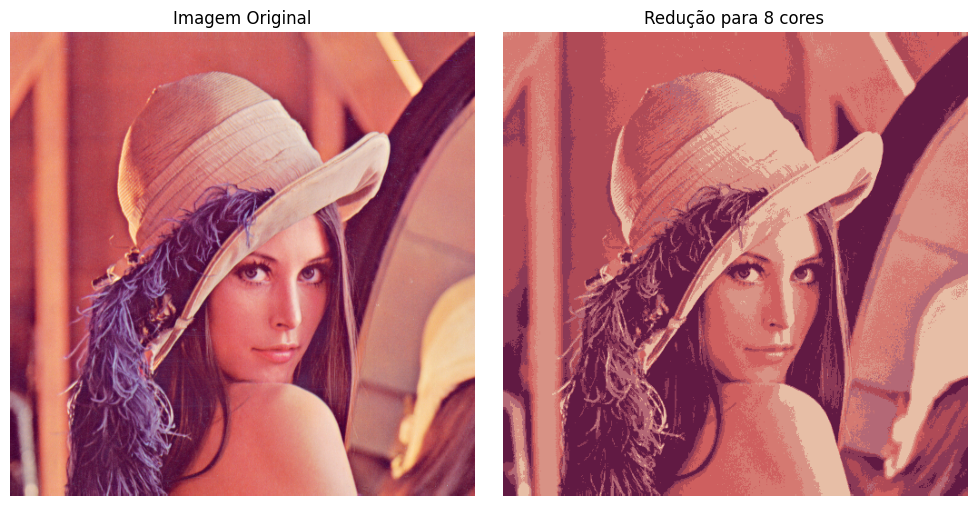

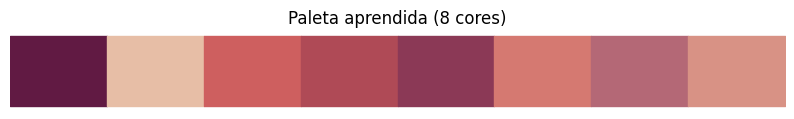


🧠 Treinando GNG com max_nodes = 16...
📏 Inércia média: 14.18
🎯 Cores únicas após GNG: 16 (limite = 16)


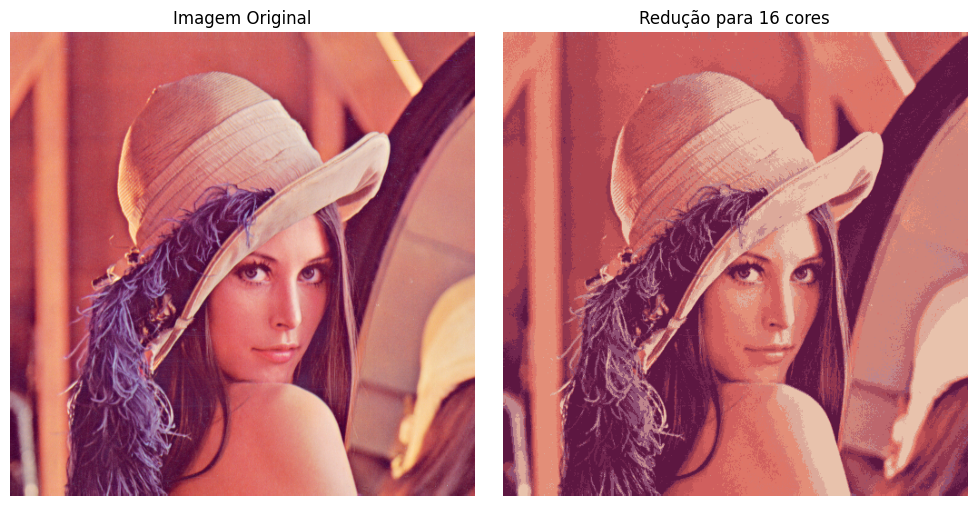

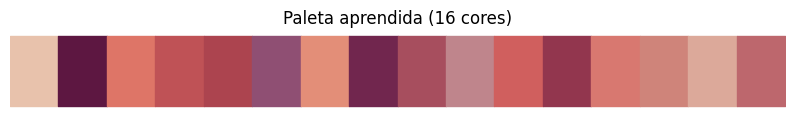


🧠 Treinando GNG com max_nodes = 32...
📏 Inércia média: 10.45
🎯 Cores únicas após GNG: 32 (limite = 32)


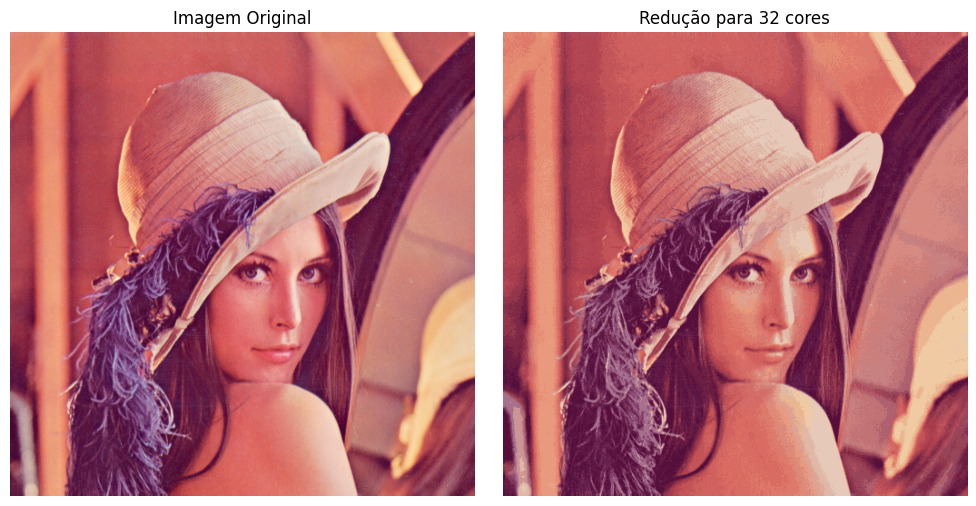

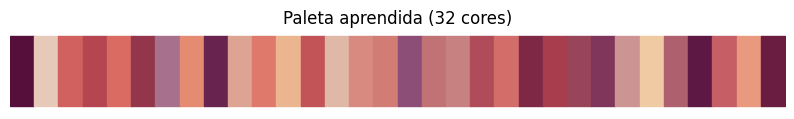


🧠 Treinando GNG com max_nodes = 64...
📏 Inércia média: 8.37
🎯 Cores únicas após GNG: 64 (limite = 64)


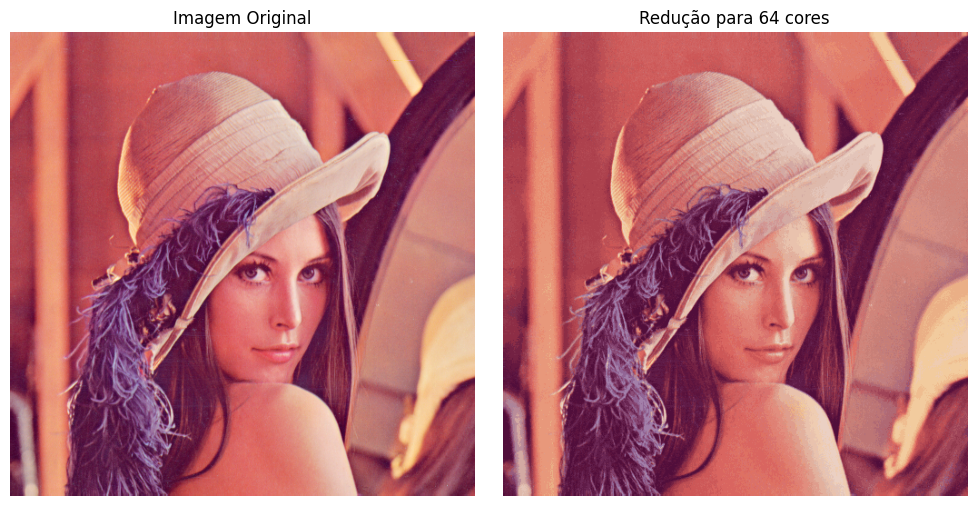

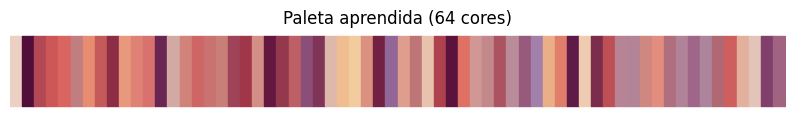


🧠 Treinando GNG com max_nodes = 128...
📏 Inércia média: 7.07
🎯 Cores únicas após GNG: 128 (limite = 128)


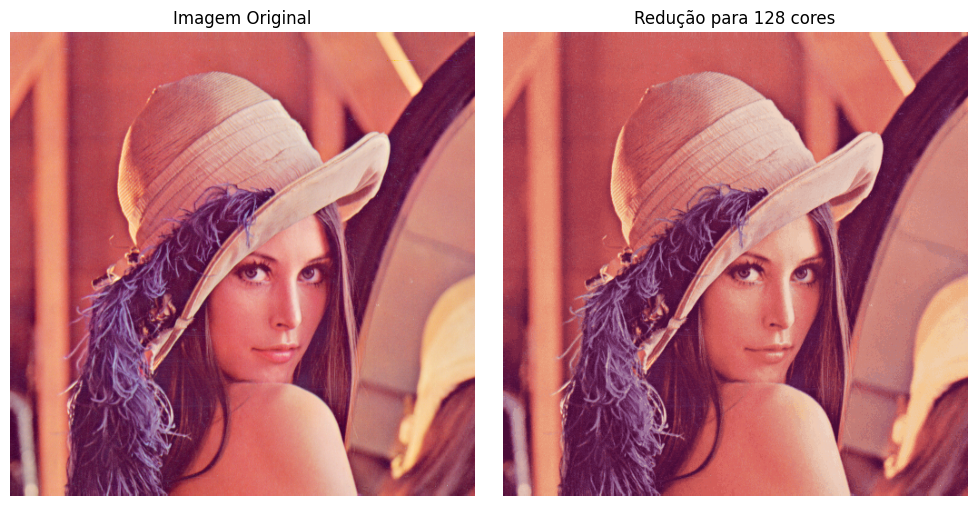

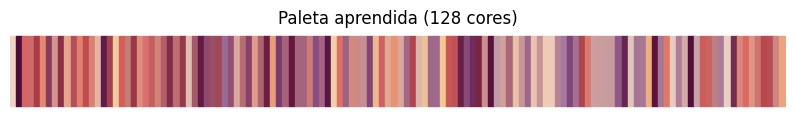

In [ ]:
url = 'https://raw.githubusercontent.com/R1chardJr/Color_Reduction_GNG/main/Lenna.png'
resp = urllib.request.urlopen(url)
image_array = np.asarray(bytearray(resp.read()), dtype=np.uint8)
image = cv2.imdecode(image_array, cv2.IMREAD_COLOR)
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
pixels = image_rgb.reshape(-1, 3).astype(np.float32)

def closest_color(pixel, centers):
    distances = np.linalg.norm(centers - pixel, axis=1)
    return centers[np.argmin(distances)]

def count_unique_colors(image_array):
    flat = image_array.reshape(-1, 3)
    unique_colors = np.unique(flat, axis=0)
    return len(unique_colors), flat.shape[0]

for max_nodes in [8, 16, 32, 64,128]:
    print(f"\n🧠 Treinando GNG com max_nodes = {max_nodes}...")

    gng = GNG(max_nodes=max_nodes, max_iter=7500, eps_b=0.05, eps_n=0.005,
              alpha=0.5, lambda_insert=50, amax=90, beta=0.005)
    gng.fit(pixels)
    centers = gng.get_centers()

    reduced_pixels = np.array([closest_color(p, centers) for p in pixels])
    reduced_image = reduced_pixels.reshape(image_rgb.shape).astype(np.uint8)

    _, dists = pairwise_distances_argmin_min(pixels, centers)
    inertia = np.mean(dists)

    original_colors, original_pixels = count_unique_colors(image_rgb)
    reduced_colors, reduced_pixels = count_unique_colors(reduced_image)

    print(f"📏 Inércia média: {inertia:.2f}")
    print(f"🎯 Cores únicas após GNG: {reduced_colors} (limite = {max_nodes})")

    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.title("Imagem Original")
    plt.imshow(image_rgb)
    plt.axis("off")

    plt.subplot(1, 2, 2)
    plt.title(f"Redução para {max_nodes} cores")
    plt.imshow(reduced_image)
    plt.axis("off")
    plt.tight_layout()
    plt.show()

    plt.figure(figsize=(10, 1))
    for i, color in enumerate(centers.astype(np.uint8)):
        plt.fill_between([i, i + 1], 0, 1, color=color / 255.0)
    plt.xlim(0, len(centers))
    plt.axis('off')
    plt.title(f'Paleta aprendida ({len(centers)} cores)')
    plt.show()



🧠 Treinando GNG com λ = 20...
📏 Inércia média: 7.03
🎯 Cores únicas após GNG: 128 (limite = 128)


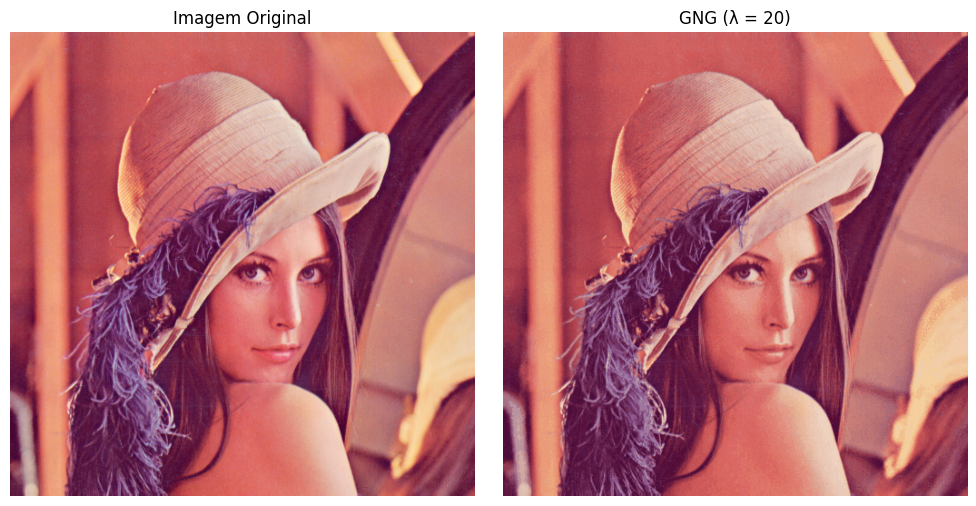

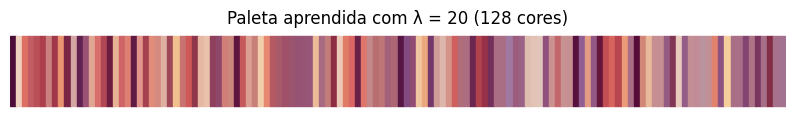


🧠 Treinando GNG com λ = 35...
📏 Inércia média: 7.13
🎯 Cores únicas após GNG: 128 (limite = 128)


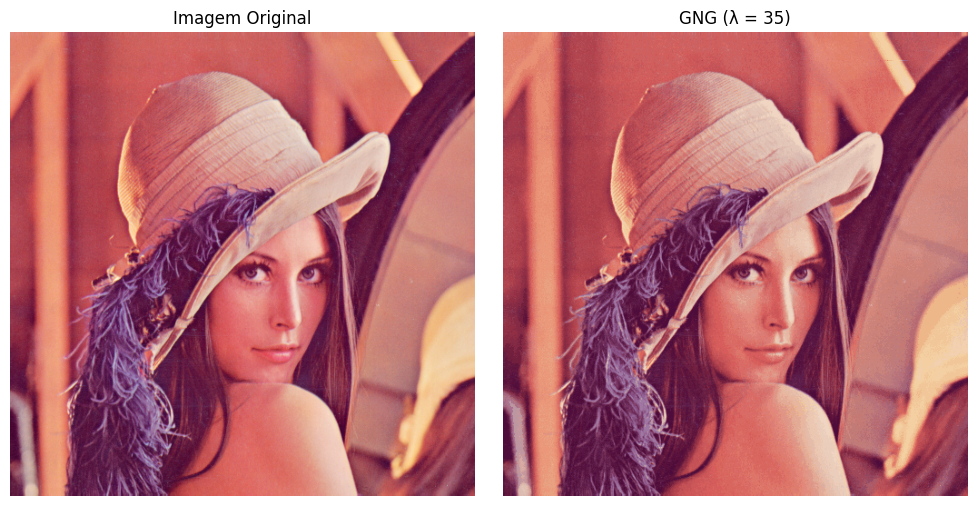

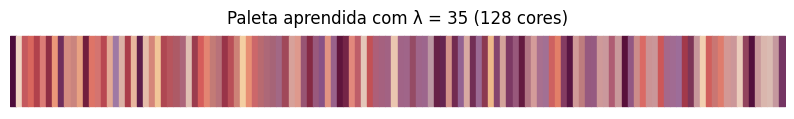


🧠 Treinando GNG com λ = 50...
📏 Inércia média: 7.06
🎯 Cores únicas após GNG: 128 (limite = 128)


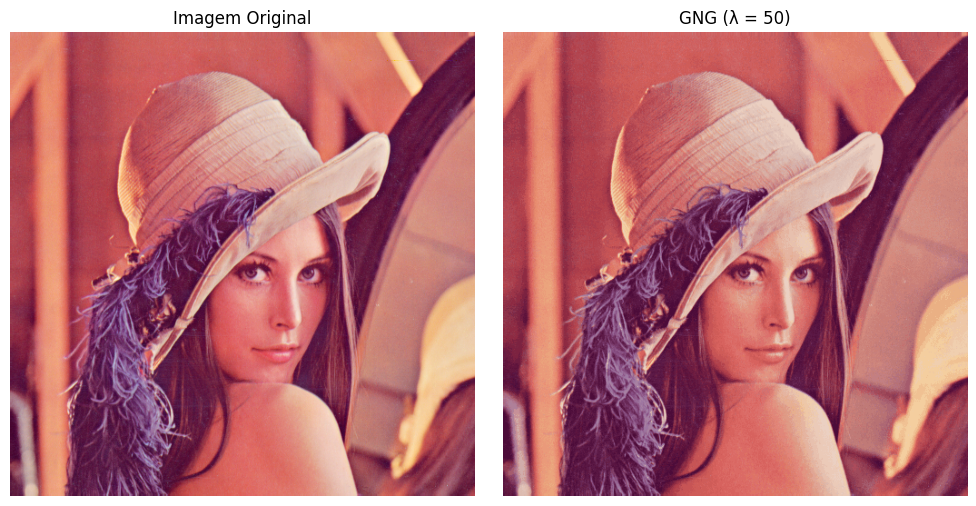

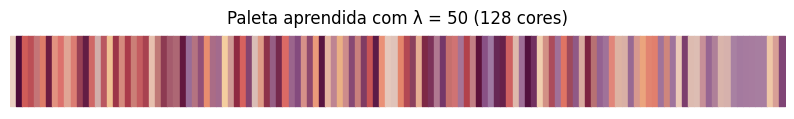


🧠 Treinando GNG com λ = 70...
📏 Inércia média: 7.23
🎯 Cores únicas após GNG: 109 (limite = 128)


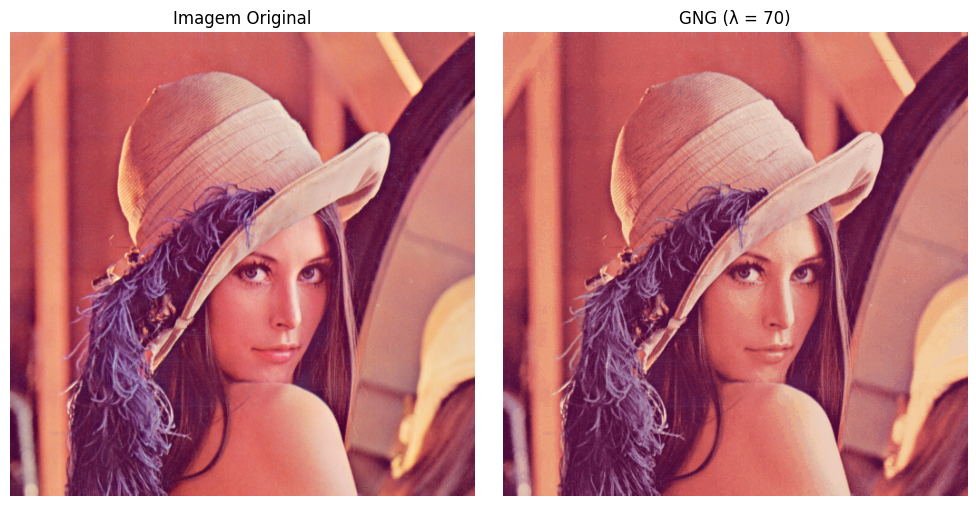

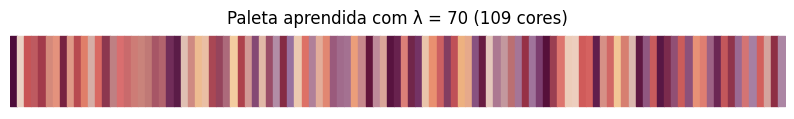


🧠 Treinando GNG com λ = 100...
📏 Inércia média: 8.17
🎯 Cores únicas após GNG: 77 (limite = 128)


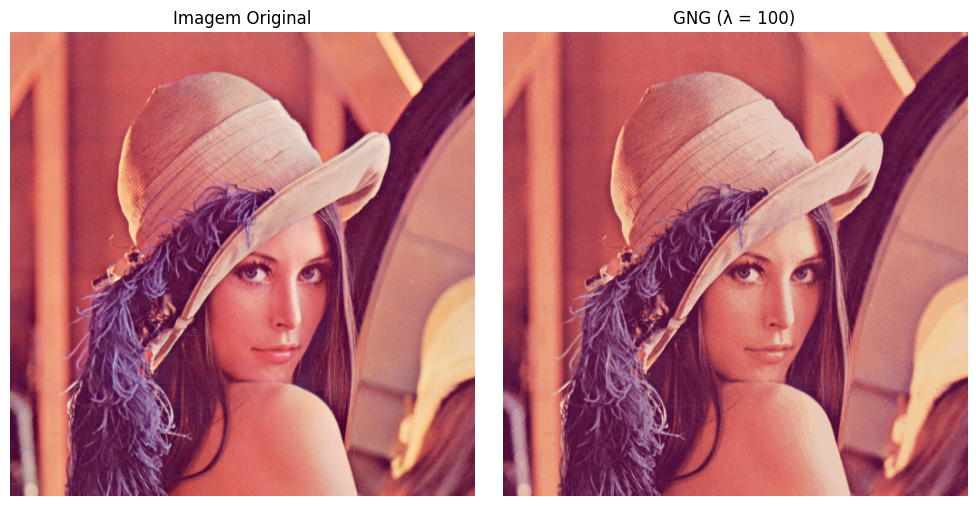

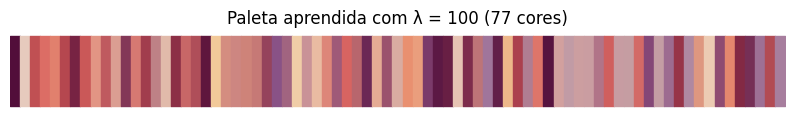

In [ ]:
url = 'https://raw.githubusercontent.com/R1chardJr/Color_Reduction_GNG/main/Lenna.png'
resp = urllib.request.urlopen(url)
image_array = np.asarray(bytearray(resp.read()), dtype=np.uint8)
image = cv2.imdecode(image_array, cv2.IMREAD_COLOR)
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
pixels = image_rgb.reshape(-1, 3).astype(np.float32)

def closest_color(pixel, centers):
    distances = np.linalg.norm(centers - pixel, axis=1)
    return centers[np.argmin(distances)]

def count_unique_colors(image_array):
    flat = image_array.reshape(-1, 3)
    unique_colors = np.unique(flat, axis=0)
    return len(unique_colors), flat.shape[0]

lambda_values = [20, 35, 50, 70, 100]
max_nodes = 128
max_iter = 7500

for lambda_insert in lambda_values:
    print(f"\n🧠 Treinando GNG com λ = {lambda_insert}...")

    gng = GNG(max_nodes=max_nodes, max_iter=max_iter,
              eps_b=0.05, eps_n=0.005,
              alpha=0.5, lambda_insert=lambda_insert,
              amax=90, beta=0.005)

    gng.fit(pixels)
    centers = gng.get_centers()

    reduced_pixels = np.array([closest_color(p, centers) for p in pixels])
    reduced_image = reduced_pixels.reshape(image_rgb.shape).astype(np.uint8)

    _, dists = pairwise_distances_argmin_min(pixels, centers)
    inertia = np.mean(dists)

    original_colors, original_pixels = count_unique_colors(image_rgb)
    reduced_colors, reduced_pixels = count_unique_colors(reduced_image)

    print(f"📏 Inércia média: {inertia:.2f}")
    print(f"🎯 Cores únicas após GNG: {reduced_colors} (limite = {max_nodes})")

    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.title("Imagem Original")
    plt.imshow(image_rgb)
    plt.axis("off")

    plt.subplot(1, 2, 2)
    plt.title(f"GNG (λ = {lambda_insert})")
    plt.imshow(reduced_image)
    plt.axis("off")

    plt.tight_layout()
    plt.show()

    plt.figure(figsize=(10, 1))
    for i, color in enumerate(centers.astype(np.uint8)):
        plt.fill_between([i, i + 1], 0, 1, color=color / 255.0)
    plt.xlim(0, len(centers))
    plt.axis('off')
    plt.title(f'Paleta aprendida com λ = {lambda_insert} ({len(centers)} cores)')
    plt.show()


Como é possível observar, o mesmo padrão se repetiu, os parâmetros que se saíram melhor foram os mesmos que na imagem anterior. A única diferença seria a inércia que foi maior em comparação com a imagem das taças, mas isso é decorrente do fato de a imagem da lenna ter cores que são muito mais parecidas uma com as outras, e mesmo assim ainda se trata de um número baixo.

# Avaliando novamente
Repetindo as mesmas avaliações feitas no caso da imagem anterior

🖼️ Imagem original: 148279 cores únicas em 262144 pixels
🎯 Imagem reduzida: 128 cores únicas em 262144 pixels
📏 Inércia média: 7.06
🎯 Cores únicas após GNG: 128 (limite = 128)


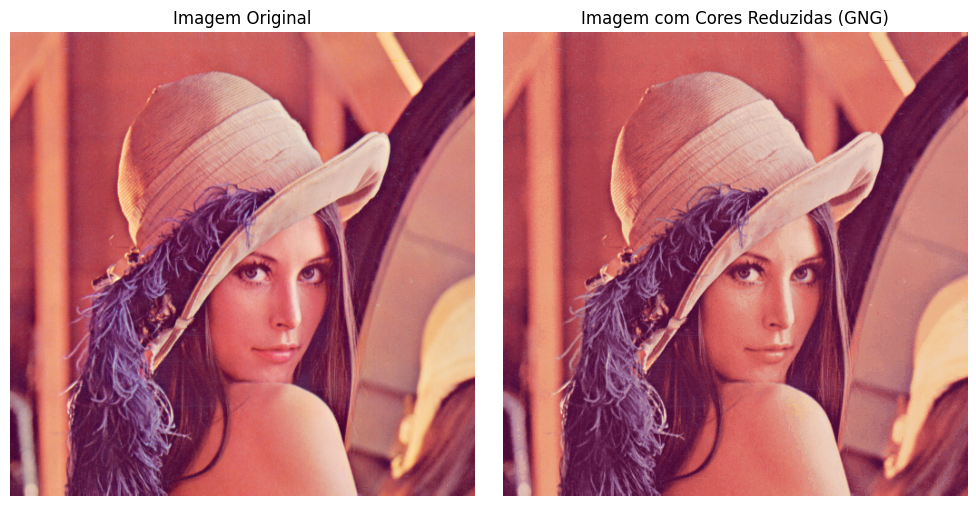

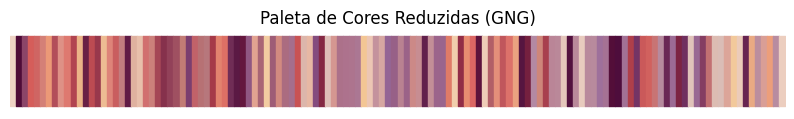

In [ ]:
url = 'https://raw.githubusercontent.com/R1chardJr/Color_Reduction_GNG/main/Lenna.png'
resp = urllib.request.urlopen(url)
image_array = np.asarray(bytearray(resp.read()), dtype=np.uint8)
image = cv2.imdecode(image_array, cv2.IMREAD_COLOR)
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
pixels = image_rgb.reshape(-1, 3).astype(np.float32)

gng = GNG(max_nodes=128, max_iter=7500, eps_b=0.05, eps_n=0.005, alpha=0.5, lambda_insert=50, amax=90, beta=0.005)
gng.fit(pixels)
centers = gng.get_centers()

def closest_color(pixel):
    distances = np.linalg.norm(centers - pixel, axis=1)
    return centers[np.argmin(distances)]

reduced_pixels = np.array([closest_color(p) for p in pixels])
reduced_image = reduced_pixels.reshape(image_rgb.shape).astype(np.uint8)

def count_unique_colors(image_array):
    flat = image_array.reshape(-1, 3)
    unique_colors = np.unique(flat, axis=0)
    return len(unique_colors), flat.shape[0]

original_colors, original_pixels = count_unique_colors(image_rgb)
reduced_colors, reduced_pixels = count_unique_colors(reduced_image)

print(f"🖼️ Imagem original: {original_colors} cores únicas em {original_pixels} pixels")
print(f"🎯 Imagem reduzida: {reduced_colors} cores únicas em {reduced_pixels} pixels")

_, dists = pairwise_distances_argmin_min(pixels, centers)
inertia = np.mean(dists)

original_colors, original_pixels = count_unique_colors(image_rgb)
reduced_colors, reduced_pixels = count_unique_colors(reduced_image)

print(f"📏 Inércia média: {inertia:.2f}")
print(f"🎯 Cores únicas após GNG: {reduced_colors} (limite = {max_nodes})")

plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.title("Imagem Original")
plt.imshow(image_rgb)
plt.axis("off")

plt.subplot(1, 2, 2)
plt.title("Imagem com Cores Reduzidas (GNG)")
plt.imshow(reduced_image)
plt.axis("off")

plt.tight_layout()
plt.show()

plt.figure(figsize=(10, 1))
for i, color in enumerate(centers.astype(np.uint8)):
    plt.fill_between([i, i + 1], 0, 1, color=color / 255.0)
plt.xlim(0, len(centers))
plt.axis('off')
plt.title('Paleta de Cores Reduzidas (GNG)')
plt.show()

Como podemos ver, a diferença entre a imagem original e a imagem após a redução de cores é miníma, as duas imagens são visualmente muito semelhantes, a inércia baixa também confirma isso. Então, após uma redução de 148279 cores para 128, uma redução de cerca de 1158 vezes temos imagens completamente parecidas.

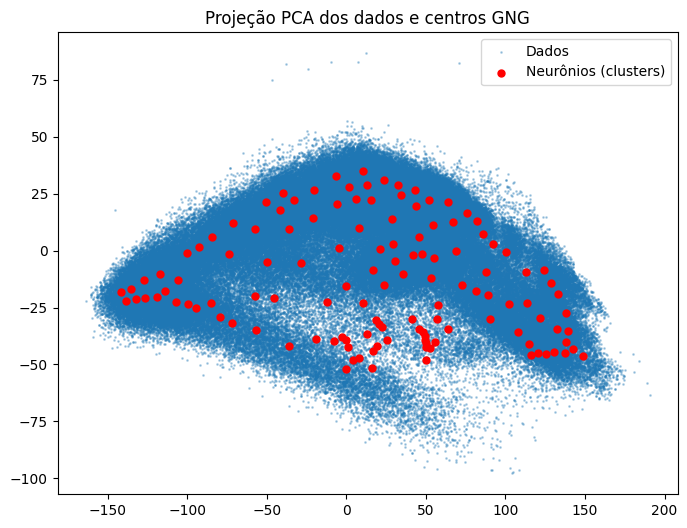

In [ ]:
pca = PCA(n_components=2)
data_2d = pca.fit_transform(pixels)
centers_2d = pca.transform(centers)

plt.figure(figsize=(8, 6))
plt.scatter(data_2d[:, 0], data_2d[:, 1], s=1, alpha=0.3, label='Dados')
plt.scatter(centers_2d[:, 0], centers_2d[:, 1], c='red', s=25, label='Neurônios (clusters)')
plt.title('Projeção PCA dos dados e centros GNG')
plt.legend()
plt.show()


Pela projeção PCA, já pela segunda vez, é possível ver que a rede GNG está representando bem o espaço dos dados. Os neurônios estão juntos de onde está os dados, assim todos os dados originais são representados.

In [ ]:
labels = np.argmin(np.linalg.norm(pixels[:, None] - centers[None, :], axis=2), axis=1)

score = silhouette_score(pixels, labels)
print(f"🧪 Silhouette score (homogeneidade): {score:.3f}")


🧪 Silhouette score (homogeneidade): 0.194


Dessa vez o Silhouette score foi de 0.194, indicando que há alguns clusters se soberpondo, mas isso acontece devido a imagem apresentar cores muito semelhantes e estando elas próximas na imagem tambem, colaborando para esse resultado.

# Fazendo o processo com outras imagens
Testando fazer a redução de cores com outras imagens da biblioteca skimage

🖼️ Imagem original: 113382 cores únicas em 262144 pixels
🎯 Imagem reduzida: 128 cores únicas em 262144 pixels
📏 Inércia média: 7.15


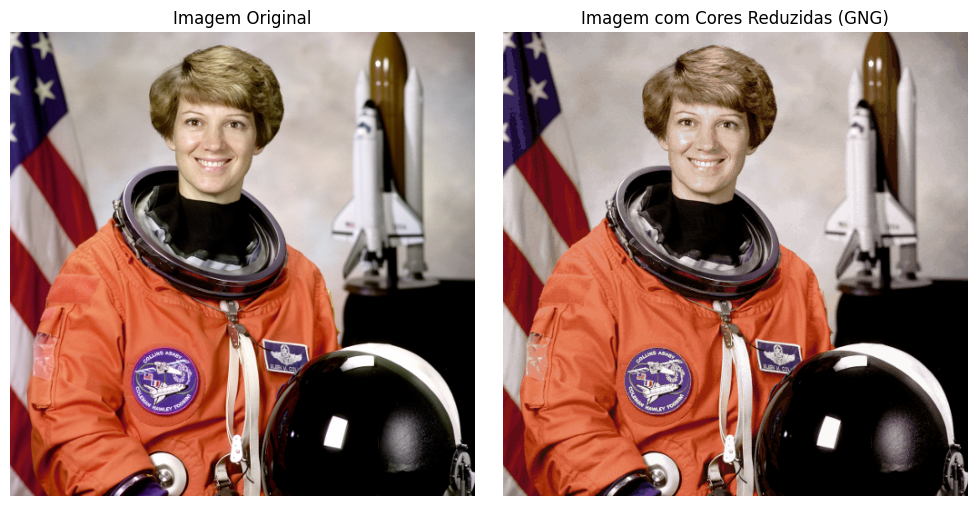

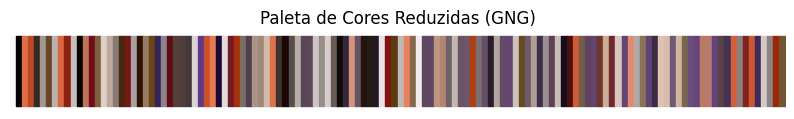

In [ ]:
image_rgb = data.astronaut()
pixels = image_rgb.reshape(-1, 3).astype(np.float32)

gng = GNG(max_nodes=128, max_iter=7500, eps_b=0.05, eps_n=0.005, alpha=0.5, lambda_insert=50, amax=90, beta=0.005)
gng.fit(pixels)
centers = gng.get_centers()

def closest_color(pixel):
    distances = np.linalg.norm(centers - pixel, axis=1)
    return centers[np.argmin(distances)]

reduced_pixels = np.array([closest_color(p) for p in pixels])
reduced_image = reduced_pixels.reshape(image_rgb.shape).astype(np.uint8)

def count_unique_colors(image_array):
    flat = image_array.reshape(-1, 3)
    unique_colors = np.unique(flat, axis=0)
    return len(unique_colors), flat.shape[0]

original_colors, original_pixels = count_unique_colors(image_rgb)
reduced_colors, reduced_pixels = count_unique_colors(reduced_image)

print(f"🖼️ Imagem original: {original_colors} cores únicas em {original_pixels} pixels")
print(f"🎯 Imagem reduzida: {reduced_colors} cores únicas em {reduced_pixels} pixels")

_, dists = pairwise_distances_argmin_min(pixels, centers)
inertia = np.mean(dists)

original_colors, original_pixels = count_unique_colors(image_rgb)
reduced_colors, reduced_pixels = count_unique_colors(reduced_image)

print(f"📏 Inércia média: {inertia:.2f}")

plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.title("Imagem Original")
plt.imshow(image_rgb)
plt.axis("off")

plt.subplot(1, 2, 2)
plt.title("Imagem com Cores Reduzidas (GNG)")
plt.imshow(reduced_image)
plt.axis("off")

plt.tight_layout()
plt.show()

plt.figure(figsize=(10, 1))
for i, color in enumerate(centers.astype(np.uint8)):
    plt.fill_between([i, i + 1], 0, 1, color=color / 255.0)
plt.xlim(0, len(centers))
plt.axis('off')
plt.title('Paleta de Cores Reduzidas (GNG)')
plt.show()

A diferença entre as imagens são muito pequenas, apenas uma questão de detalhes, mas não a perca de algum tipo de informação decorrente da troca de cores.

🖼️ Imagem original: 32584 cores únicas em 135300 pixels
🎯 Imagem reduzida: 128 cores únicas em 135300 pixels
📏 Inércia média: 5.50


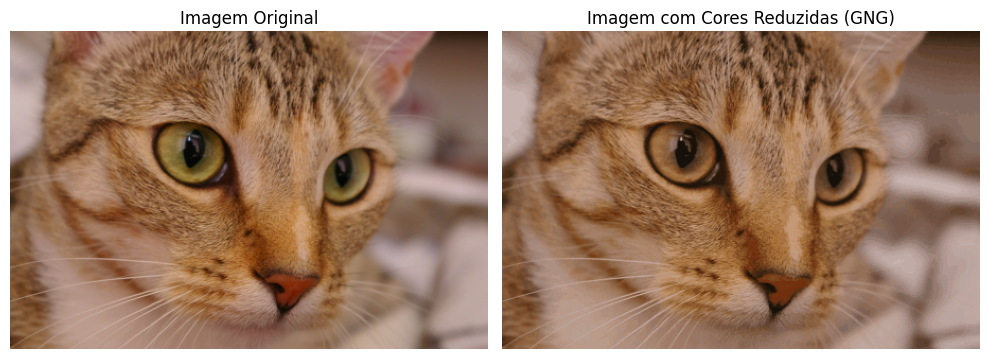

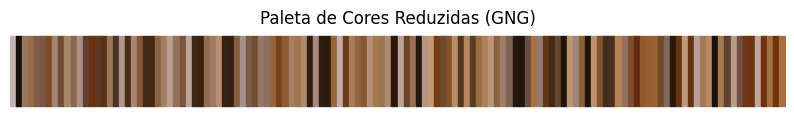

In [ ]:
image_rgb = data.chelsea()
pixels = image_rgb.reshape(-1, 3).astype(np.float32)

gng = GNG(max_nodes=128, max_iter=7500, eps_b=0.05, eps_n=0.005, alpha=0.5, lambda_insert=50, amax=90, beta=0.005)
gng.fit(pixels)
centers = gng.get_centers()

def closest_color(pixel):
    distances = np.linalg.norm(centers - pixel, axis=1)
    return centers[np.argmin(distances)]

reduced_pixels = np.array([closest_color(p) for p in pixels])
reduced_image = reduced_pixels.reshape(image_rgb.shape).astype(np.uint8)

def count_unique_colors(image_array):
    flat = image_array.reshape(-1, 3)
    unique_colors = np.unique(flat, axis=0)
    return len(unique_colors), flat.shape[0]

original_colors, original_pixels = count_unique_colors(image_rgb)
reduced_colors, reduced_pixels = count_unique_colors(reduced_image)

print(f"🖼️ Imagem original: {original_colors} cores únicas em {original_pixels} pixels")
print(f"🎯 Imagem reduzida: {reduced_colors} cores únicas em {reduced_pixels} pixels")

_, dists = pairwise_distances_argmin_min(pixels, centers)
inertia = np.mean(dists)

original_colors, original_pixels = count_unique_colors(image_rgb)
reduced_colors, reduced_pixels = count_unique_colors(reduced_image)

print(f"📏 Inércia média: {inertia:.2f}")

plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.title("Imagem Original")
plt.imshow(image_rgb)
plt.axis("off")

plt.subplot(1, 2, 2)
plt.title("Imagem com Cores Reduzidas (GNG)")
plt.imshow(reduced_image)
plt.axis("off")

plt.tight_layout()
plt.show()

plt.figure(figsize=(10, 1))
for i, color in enumerate(centers.astype(np.uint8)):
    plt.fill_between([i, i + 1], 0, 1, color=color / 255.0)
plt.xlim(0, len(centers))
plt.axis('off')
plt.title('Paleta de Cores Reduzidas (GNG)')
plt.show()

Mais um caso com diferença miníma, apenas no verde dos olhos, pois na imagem original há pouco uso dessa cor em relação as outras.

🖼️ Imagem original: 45526 cores únicas em 273280 pixels
🎯 Imagem reduzida: 128 cores únicas em 273280 pixels
📏 Inércia média: 5.56


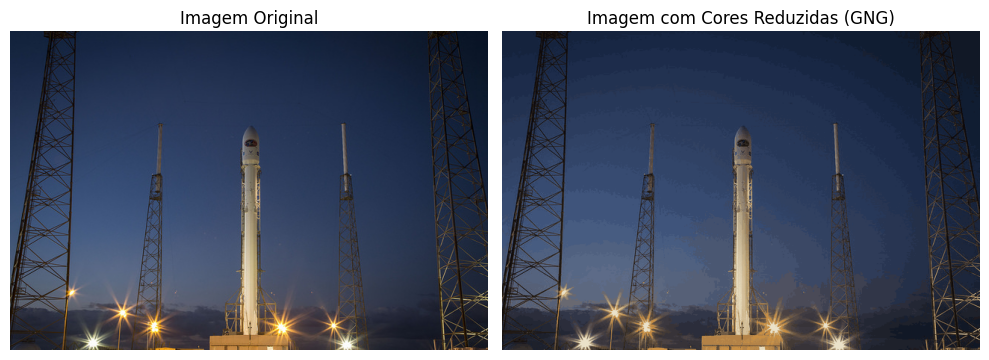

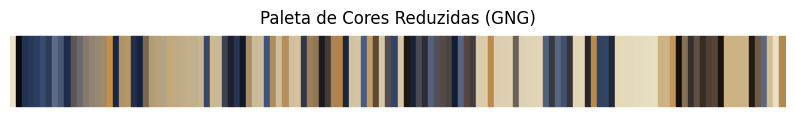

In [ ]:
image_rgb = data.rocket()
pixels = image_rgb.reshape(-1, 3).astype(np.float32)

gng = GNG(max_nodes=128, max_iter=7500, eps_b=0.05, eps_n=0.005, alpha=0.5, lambda_insert=50, amax=90, beta=0.005)
gng.fit(pixels)
centers = gng.get_centers()

def closest_color(pixel):
    distances = np.linalg.norm(centers - pixel, axis=1)
    return centers[np.argmin(distances)]

reduced_pixels = np.array([closest_color(p) for p in pixels])
reduced_image = reduced_pixels.reshape(image_rgb.shape).astype(np.uint8)

def count_unique_colors(image_array):
    flat = image_array.reshape(-1, 3)
    unique_colors = np.unique(flat, axis=0)
    return len(unique_colors), flat.shape[0]

original_colors, original_pixels = count_unique_colors(image_rgb)
reduced_colors, reduced_pixels = count_unique_colors(reduced_image)

print(f"🖼️ Imagem original: {original_colors} cores únicas em {original_pixels} pixels")
print(f"🎯 Imagem reduzida: {reduced_colors} cores únicas em {reduced_pixels} pixels")

_, dists = pairwise_distances_argmin_min(pixels, centers)
inertia = np.mean(dists)

original_colors, original_pixels = count_unique_colors(image_rgb)
reduced_colors, reduced_pixels = count_unique_colors(reduced_image)

print(f"📏 Inércia média: {inertia:.2f}")

plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.title("Imagem Original")
plt.imshow(image_rgb)
plt.axis("off")

plt.subplot(1, 2, 2)
plt.title("Imagem com Cores Reduzidas (GNG)")
plt.imshow(reduced_image)
plt.axis("off")

plt.tight_layout()
plt.show()

plt.figure(figsize=(10, 1))
for i, color in enumerate(centers.astype(np.uint8)):
    plt.fill_between([i, i + 1], 0, 1, color=color / 255.0)
plt.xlim(0, len(centers))
plt.axis('off')
plt.title('Paleta de Cores Reduzidas (GNG)')
plt.show()

Nesse caso, com a escala de azul do céu, ficou perceptível a mudança de cores, uma forma de eliminar isso seria aumentando o número de neurônios, mas ai já estaria fugindo do foco desse projeto

🖼️ Imagem original: 94478 cores únicas em 240000 pixels
🎯 Imagem reduzida: 128 cores únicas em 240000 pixels
📏 Inércia média: 5.72


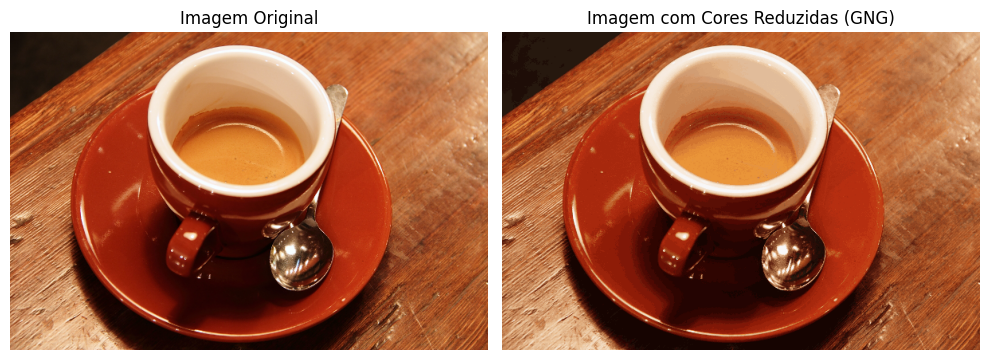

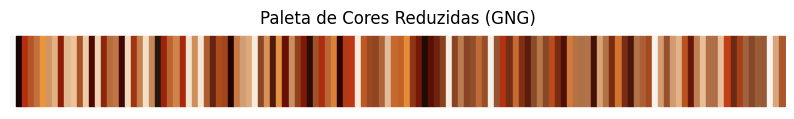

In [ ]:
image_rgb = data.coffee()
pixels = image_rgb.reshape(-1, 3).astype(np.float32)

gng = GNG(max_nodes=128, max_iter=7500, eps_b=0.05, eps_n=0.005, alpha=0.5, lambda_insert=50, amax=90, beta=0.005)
gng.fit(pixels)
centers = gng.get_centers()

def closest_color(pixel):
    distances = np.linalg.norm(centers - pixel, axis=1)
    return centers[np.argmin(distances)]

reduced_pixels = np.array([closest_color(p) for p in pixels])
reduced_image = reduced_pixels.reshape(image_rgb.shape).astype(np.uint8)

def count_unique_colors(image_array):
    flat = image_array.reshape(-1, 3)
    unique_colors = np.unique(flat, axis=0)
    return len(unique_colors), flat.shape[0]

original_colors, original_pixels = count_unique_colors(image_rgb)
reduced_colors, reduced_pixels = count_unique_colors(reduced_image)

print(f"🖼️ Imagem original: {original_colors} cores únicas em {original_pixels} pixels")
print(f"🎯 Imagem reduzida: {reduced_colors} cores únicas em {reduced_pixels} pixels")

_, dists = pairwise_distances_argmin_min(pixels, centers)
inertia = np.mean(dists)

original_colors, original_pixels = count_unique_colors(image_rgb)
reduced_colors, reduced_pixels = count_unique_colors(reduced_image)

print(f"📏 Inércia média: {inertia:.2f}")

plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.title("Imagem Original")
plt.imshow(image_rgb)
plt.axis("off")

plt.subplot(1, 2, 2)
plt.title("Imagem com Cores Reduzidas (GNG)")
plt.imshow(reduced_image)
plt.axis("off")

plt.tight_layout()
plt.show()

plt.figure(figsize=(10, 1))
for i, color in enumerate(centers.astype(np.uint8)):
    plt.fill_between([i, i + 1], 0, 1, color=color / 255.0)
plt.xlim(0, len(centers))
plt.axis('off')
plt.title('Paleta de Cores Reduzidas (GNG)')
plt.show()

Nesse caso a olho nu a diferença é inexistente.

🖼️ Imagem original: 45100 cores únicas em 262144 pixels
🎯 Imagem reduzida: 128 cores únicas em 262144 pixels
📏 Inércia média: 5.30


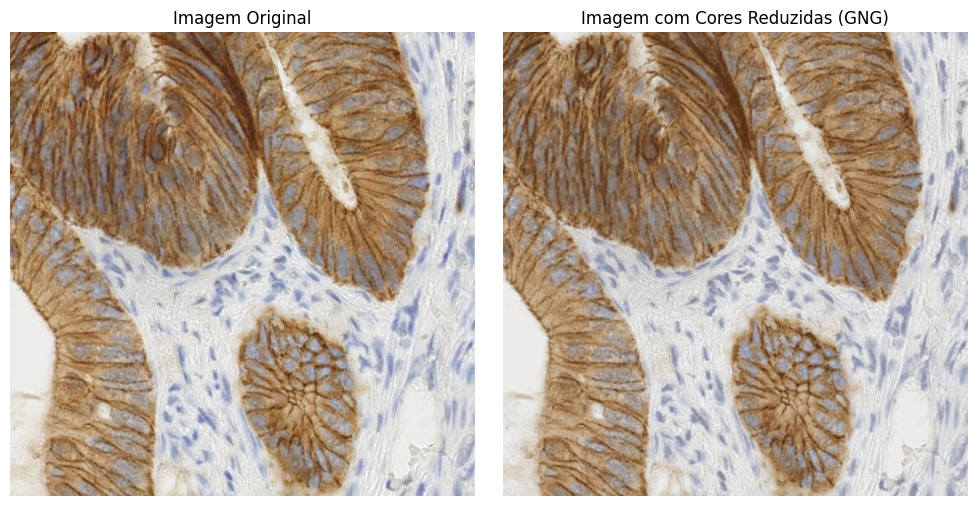

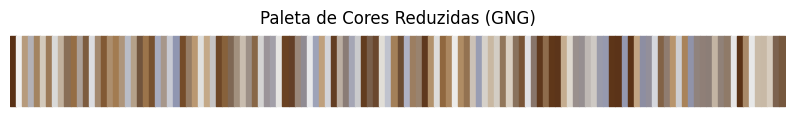

In [ ]:
image_rgb = data.immunohistochemistry()
pixels = image_rgb.reshape(-1, 3).astype(np.float32)

gng = GNG(max_nodes=128, max_iter=7500, eps_b=0.05, eps_n=0.005, alpha=0.5, lambda_insert=50, amax=90, beta=0.005)
gng.fit(pixels)
centers = gng.get_centers()

def closest_color(pixel):
    distances = np.linalg.norm(centers - pixel, axis=1)
    return centers[np.argmin(distances)]

reduced_pixels = np.array([closest_color(p) for p in pixels])
reduced_image = reduced_pixels.reshape(image_rgb.shape).astype(np.uint8)

def count_unique_colors(image_array):
    flat = image_array.reshape(-1, 3)
    unique_colors = np.unique(flat, axis=0)
    return len(unique_colors), flat.shape[0]

original_colors, original_pixels = count_unique_colors(image_rgb)
reduced_colors, reduced_pixels = count_unique_colors(reduced_image)

print(f"🖼️ Imagem original: {original_colors} cores únicas em {original_pixels} pixels")
print(f"🎯 Imagem reduzida: {reduced_colors} cores únicas em {reduced_pixels} pixels")

_, dists = pairwise_distances_argmin_min(pixels, centers)
inertia = np.mean(dists)

original_colors, original_pixels = count_unique_colors(image_rgb)
reduced_colors, reduced_pixels = count_unique_colors(reduced_image)

print(f"📏 Inércia média: {inertia:.2f}")

plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.title("Imagem Original")
plt.imshow(image_rgb)
plt.axis("off")

plt.subplot(1, 2, 2)
plt.title("Imagem com Cores Reduzidas (GNG)")
plt.imshow(reduced_image)
plt.axis("off")

plt.tight_layout()
plt.show()

plt.figure(figsize=(10, 1))
for i, color in enumerate(centers.astype(np.uint8)):
    plt.fill_between([i, i + 1], 0, 1, color=color / 255.0)
plt.xlim(0, len(centers))
plt.axis('off')
plt.title('Paleta de Cores Reduzidas (GNG)')
plt.show()

No caso da imagem do tecido, as duas imagens são muito semelhantes, sem deixar perder alguma qualidade.

# Conclusão

Como foi observado ao longo dos testes, a rede GNG cumpriu bem seu papel na tarefa de redução de cores. A variação dos parâmetros — especialmente as taxas de aprendizado e o número máximo de neurônios — foi o que mais impactou a diferença visual entre a imagem original e a imagem reduzida, evidenciando a importância de encontrar os valores ideais para esses hiperparâmetros.

Naturalmente, quanto maior o número de neurônios (e, consequentemente, de cores finais), melhor a qualidade da imagem reduzida. No entanto, isso também contraria o objetivo principal de compressão. Por isso, foi necessário buscar um equilíbrio entre redução e fidelidade visual, encontrando um ponto em que a imagem permaneça compreensível e representativa com o menor número possível de cores.

Dentre todas as imagens testadas, a única que apresentou resultado inferior foi a do foguete, devido à escala contínua de tons de azul no céu. Essa situação destaca um dos principais desafios da redução de cores: lidar com regiões onde há variações sutis e graduais, que produzem um grande número de cores muito próximas entre si. A GNG, apesar de adaptativa, ainda encontra dificuldade para representar essas nuances com poucos neurônios.

# Extra: Teste sua imagem
Espaço destinado para poder testar a redução de cores em qualquer imagem que for da sua escolha

In [ ]:
from google.colab import files
uploaded = files.upload()


Saving onepiece.jpg to onepiece.jpg


Não se esqueça de ter rodado a célula da rede GNG

🖼️ Imagem original: 298643 cores únicas em 8294400 pixels
🎯 Imagem reduzida: 128 cores únicas em 8294400 pixels
📏 Inércia média: 8.64
🎯 Cores únicas após GNG: 128 (limite = 128)


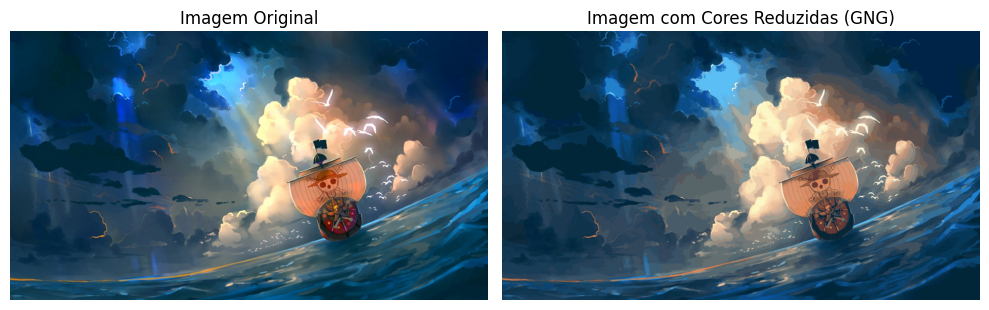

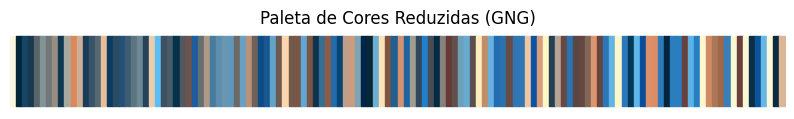

In [ ]:
img_path = list(uploaded.keys())[0]
image = cv2.imread(img_path)
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
pixels = image_rgb.reshape(-1, 3).astype(np.float32)

gng = GNG(max_nodes=128, max_iter=7500, eps_b=0.05, eps_n=0.005, alpha=0.5, lambda_insert=50, amax=90, beta=0.005)
gng.fit(pixels)
centers = gng.get_centers()

def closest_color(pixel):
    distances = np.linalg.norm(centers - pixel, axis=1)
    return centers[np.argmin(distances)]

reduced_pixels = np.array([closest_color(p) for p in pixels])
reduced_image = reduced_pixels.reshape(image_rgb.shape).astype(np.uint8)

def count_unique_colors(image_array):
    flat = image_array.reshape(-1, 3)
    unique_colors = np.unique(flat, axis=0)
    return len(unique_colors), flat.shape[0]

original_colors, original_pixels = count_unique_colors(image_rgb)
reduced_colors, reduced_pixels = count_unique_colors(reduced_image)

print(f"🖼️ Imagem original: {original_colors} cores únicas em {original_pixels} pixels")
print(f"🎯 Imagem reduzida: {reduced_colors} cores únicas em {reduced_pixels} pixels")

_, dists = pairwise_distances_argmin_min(pixels, centers)
inertia = np.mean(dists)

original_colors, original_pixels = count_unique_colors(image_rgb)
reduced_colors, reduced_pixels = count_unique_colors(reduced_image)

print(f"📏 Inércia média: {inertia:.2f}")
print(f"🎯 Cores únicas após GNG: {reduced_colors} (limite = {max_nodes})")

plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.title("Imagem Original")
plt.imshow(image_rgb)
plt.axis("off")

plt.subplot(1, 2, 2)
plt.title("Imagem com Cores Reduzidas (GNG)")
plt.imshow(reduced_image)
plt.axis("off")

plt.tight_layout()
plt.show()

plt.figure(figsize=(10, 1))
for i, color in enumerate(centers.astype(np.uint8)):
    plt.fill_between([i, i + 1], 0, 1, color=color / 255.0)
plt.xlim(0, len(centers))
plt.axis('off')
plt.title('Paleta de Cores Reduzidas (GNG)')
plt.show()